# IMAGE DATA

##### Load the directory in which the image data folders are present 
##### making a dictionary of class_counts where key is the name of class and the y axis is no of images in that clas

# Load important libraries for part 1a

In [126]:
import os
import matplotlib.pyplot as plt
import numpy as np

In [127]:
base_dir = 'IMAGE_DATA/IMAGE_DATA'
directoryoffiles = os.listdir(base_dir)
class_counts = {}

### Used len function for each directory in it
### len function tell the number of photos in each file
## Below function mentions the number of files in each folder

In [128]:
for classname in directoryoffiles:
    folder_path = os.path.join(base_dir, classname)
    if os.path.isdir(folder_path):
        num_files = len(os.listdir(folder_path))
        class_counts[classname] = num_files
        print(f"Folder: {classname} - Number of files: {num_files}")

Folder: AIRPLANE - Number of files: 20
Folder: CARS - Number of files: 20
Folder: ELEPHANTS - Number of files: 39
Folder: RANDOM - Number of files: 20
Folder: ROBOTS - Number of files: 21


#### For a data distribution that has no repeated numbers, there exists no mode.

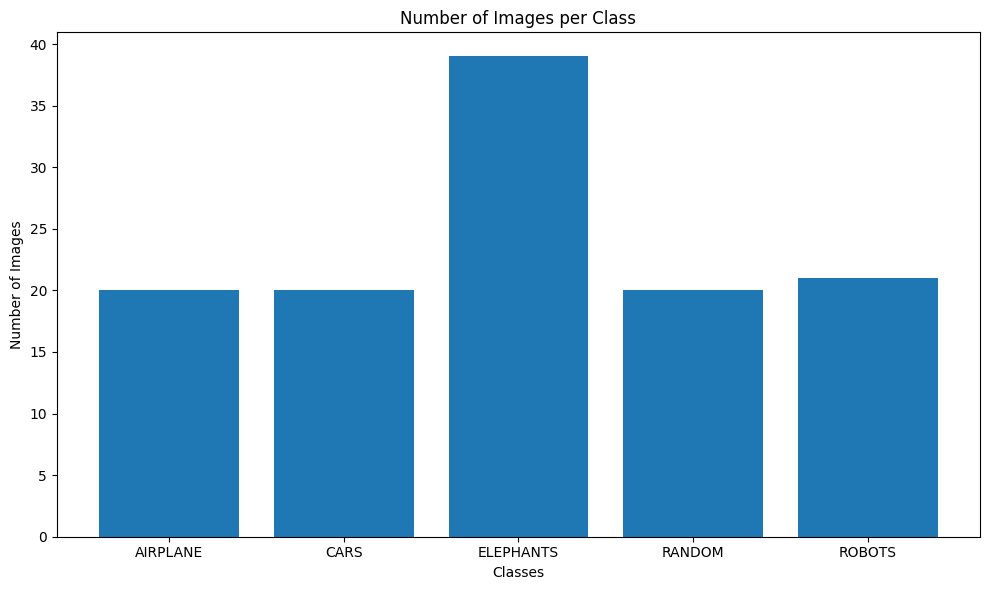

In [129]:
# Plotting the bar plot
plt.figure(figsize=(10,6))
plt.bar(class_counts.keys(), class_counts.values())
plt.xlabel('Classes')
plt.ylabel('Number of Images')
plt.title('Number of Images per Class')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


##### From the barplot it's visible that elephants images are 39 and is therefore imbalanced in terms of number of images per class  as all other classes have 20 / 21 images in the class
##### To identify the imbalanced class there are one ADVANCED METHOD WRITTEN below

In [130]:
import math


In [131]:
class_counts_values = np.array(list(class_counts.values()))
mean = np.mean(class_counts_values)
variance = np.var(class_counts_values)
std_deviation = math.sqrt(variance)  
# can change the threshold as per the data and preference
threshold = 1.8
outliers = {}


In [132]:
# Find outliers using Gaussian distribution
for cls, count in class_counts.items(): 
    z_score = (count - mean) / std_deviation
    if abs(z_score) >= threshold:
        outliers[cls] = z_score
if( len(outliers) > 0):
    print(" Imbalanced dataset")

print("Outliers (class z-scores):", outliers)

 Imbalanced dataset
Outliers (class z-scores): {'ELEPHANTS': 1.997338654842403}


#### Suggest methods to balance the dataset
###### 1. Undersample the elephants dataset because it has highest number of images . Remove some images randomly from elephants class [Preferable method in this case]
###### 2. Collect some more  images for all the dataset to balance it with elephants 
###### SMOTE (Synthetic Minority Over-sampling Technique): Generate synthetic samples for the minority class by interpolating between existing samples. SMOTE helps balance the dataset while reducing overfitting risks. [ doing for all except elephant class ]


#### 2. ⟨ 2 Marks ⟩ Randomly take 8 images from entire dataset and plot there respective histograms and label the class.
#### Constraint of below function is that it's deciding on the basis of current time which can be 
#### predictive for given time but for different time it's difficult to determine the value

In [133]:
import time
from PIL import Image
import numpy as np 

## Random Generator function

In [134]:
import time

class SimpleRandom:
    def __init__(self, seed=None):
        if seed is None:
            seed = int(time.time() * 1000000) % 1000000
        self.state = seed

    def rand(self):
        a = 1664525
        c = 1013904223
        m = 2**32
        self.state = (a * self.state + c) % m
        return self.state
    def randrange(self, start, stop):

        range_size = stop - start
        rand_num = self.rand() % range_size
        return start + rand_num

    def generaterandomnuniquenumbers(self, n, func):
        if n <= 0:
            return set()

        unique_numbers = set()
        while len(unique_numbers) < n:
            unique_numbers.add(func())

        return unique_numbers

    def generaterandomnrangeuniquenumbers(self, n, start, stop):
        if n <= 0 or start >= stop:
            return set()

        range_size = stop - start
        if n > range_size:
            n = range_size

        unique_numbers = []
        while len(unique_numbers) < n:
            num = self.randrange(start, stop)
            if num not in unique_numbers:
                unique_numbers.append(num)

        return unique_numbers



## Choose 8 random images unique

In [135]:
# Create an instance of SimpleRandom
random_generator = SimpleRandom()

randomeightindexes = []
all_indexes = list(range(sum(class_counts.values())))

# Choose 8 unique indexes without repetition
while len(randomeightindexes) < 8:
    index = random_generator.rand() % len(all_indexes)
    if index not in randomeightindexes:
        randomeightindexes.append(index)
randomeightimages = []
for randomchosenimageindexing in randomeightindexes:
    folder = list(class_counts.keys())[randomchosenimageindexing % len(class_counts)]
    num_files = class_counts[folder]
    if num_files > 0:
        folder_path = os.path.join(base_dir, folder)
        image_filenames = os.listdir(folder_path)
        image_filename = image_filenames[randomchosenimageindexing % num_files]
        image_path = os.path.join(folder_path, image_filename)
        randomeightimages.append((image_path, folder))

print(randomeightimages)


[('IMAGE_DATA/IMAGE_DATA\\CARS\\images (10).jpeg', 'CARS'), ('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (17).png', 'RANDOM'), ('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (12).png', 'RANDOM'), ('IMAGE_DATA/IMAGE_DATA\\CARS\\images (15).jpeg', 'CARS'), ('IMAGE_DATA/IMAGE_DATA\\CARS\\images (10).jpeg', 'CARS'), ('IMAGE_DATA/IMAGE_DATA\\ROBOTS\\images (10).jpeg', 'ROBOTS'), ('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (12).png', 'RANDOM'), ('IMAGE_DATA/IMAGE_DATA\\ELEPHANTS\\images (37).jpeg', 'ELEPHANTS')]


## Reference : link{https://en.wikipedia.org/wiki/Linear_congruential_generator}


In [136]:
current_time = int(time.time())
seed = current_time


## Greyscale image and plot frequency vs pixel value
### Also labelled the class

IMAGE_DATA/IMAGE_DATA\CARS\images (10).jpeg


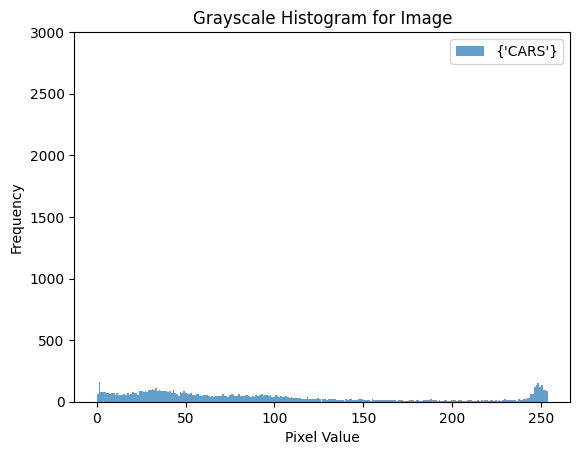

IMAGE_DATA/IMAGE_DATA\RANDOM\images (17).png


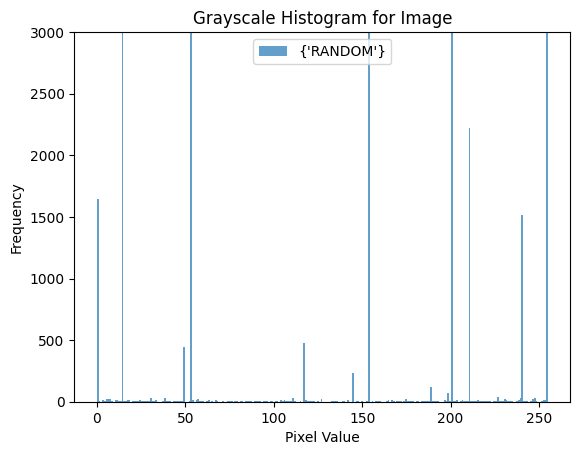

IMAGE_DATA/IMAGE_DATA\RANDOM\images (12).png


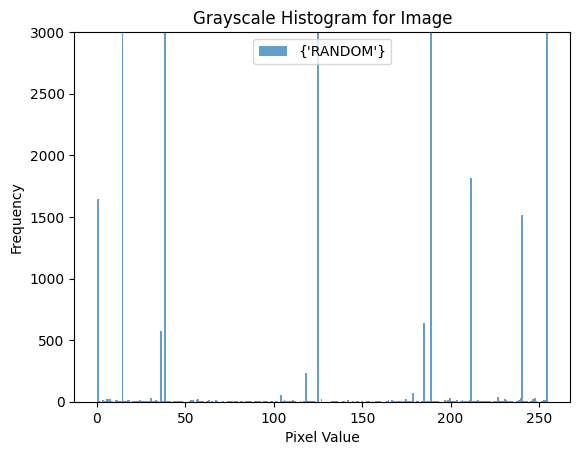

IMAGE_DATA/IMAGE_DATA\CARS\images (15).jpeg


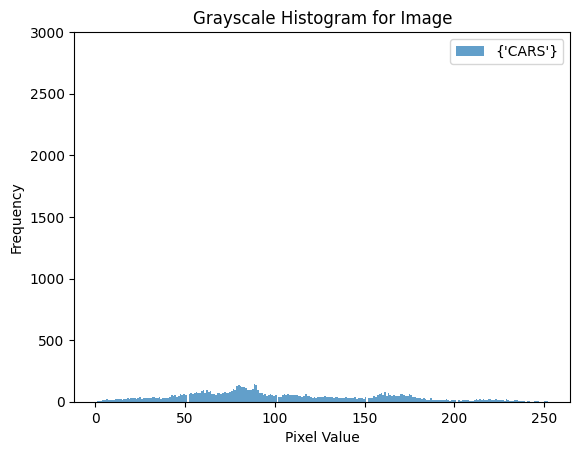

IMAGE_DATA/IMAGE_DATA\CARS\images (10).jpeg


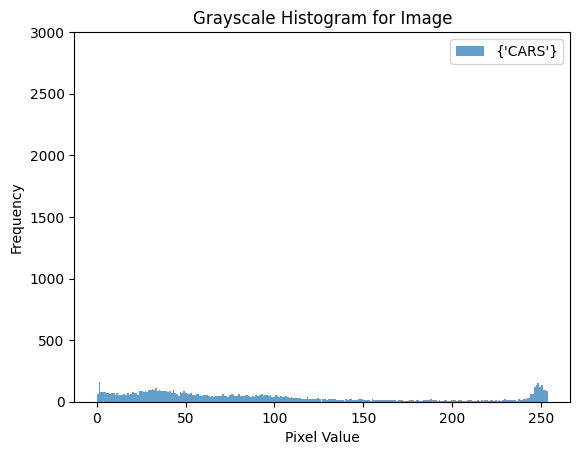

IMAGE_DATA/IMAGE_DATA\ROBOTS\images (10).jpeg


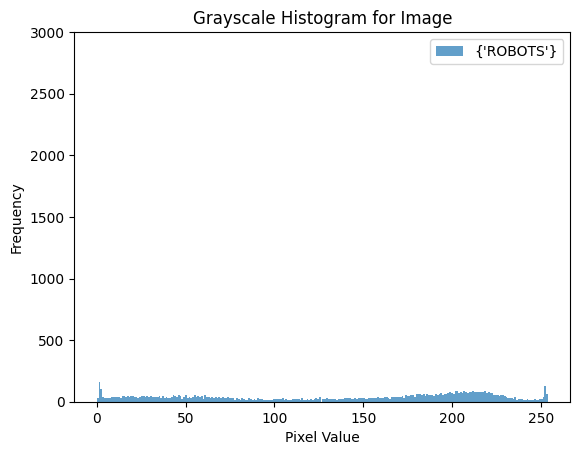

IMAGE_DATA/IMAGE_DATA\RANDOM\images (12).png


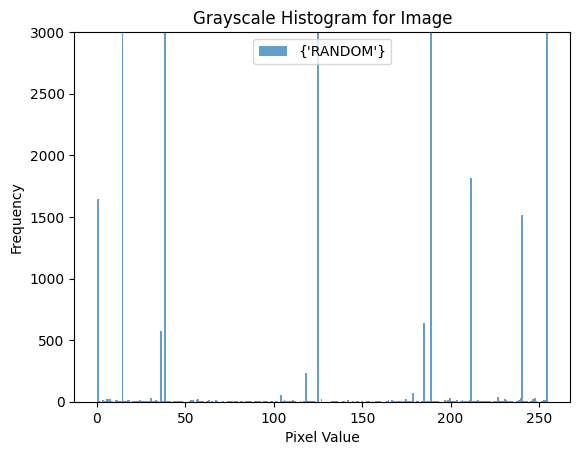

IMAGE_DATA/IMAGE_DATA\ELEPHANTS\images (37).jpeg


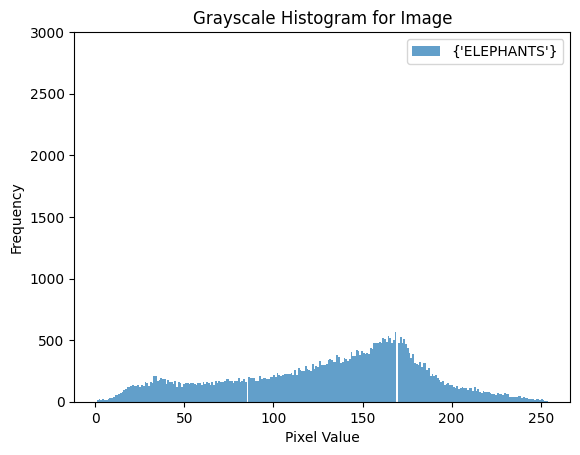

In [137]:
# Loop through selected images and convert to grayscale
for image_path, _ in randomeightimages:
    # print(image_path)

    # Convert the image to grayscale
    image = Image.open(image_path).convert('L')

    # Convert image to numpy array
    image_array = np.array(image)

    # Plot grayscale histogram for the current image
    plt.figure()
    plt.hist(image_array.ravel(), bins=256, alpha=0.7)
    plt.title('Grayscale Histogram for Image'  )
    print(image_path)
    plt.xlabel('Pixel Value')
    plt.legend([{image_path}])
    plt.legend([{_}])

    plt.ylabel('Frequency')
    plt.ylim(0, 3000)  # Adjust the y-axis limit for better visualization
    plt.show()


#### 3 ⟨ 2 Marks ⟩ Find and show mean and variance of each class. What can you deduce from these mean and variance of the data.
###### Make image_size constant for all images through all classes and each photo of each class
###### Convert image into a  matrices of dimension 256 x 256
###### Append all the matrices(of all the images in that class) 


## Resize image size

In [138]:
image_size = (256, 256)  # Define a all images to same matrix size and 256x256 pxels]

### Preprocess Image

In [139]:
def preprocessimage(image_path):
  image = Image.open(image_path)  # Load image using PIL
  image = image.convert('RGB')  # Convert to RGB format
  image = image.resize(image_size)  # Resize the image for same matrix
  image = np.array(image)  # Convert to NumPy array
  image = image.astype(np.float32) / 255.0  # Normalize pixel values to [0, 1] [which determines intensities on a scale of 0 to 1]
  return image


##### To store mean and variance for each class specific class
##### Just check if it's a directory although it's not necessary
##### Preprocess all the images of specific class
##### All images of that folder (specefic class)
#####  Mean of all the matrices of that class

## 

In [140]:
class_stats = {}
min_width = float('inf')
min_hieght = float('inf')

### Calculating mean and variance

In [141]:
# Iterate over directories (classes)
for classindirectory in directoryoffiles:
    folder_path = os.path.join(base_dir, classindirectory)
    
    classrgb = np.zeros((256, 256, 3)) 
    # print(classrgb)
     # Since after preprocessing the image size is being resized to ( 256, 256 ) 
    # therefore making a three row array of size 256 256 x 3 where each matrix position has value of its own r g b
    # Iterate over images in the current class directory
    for filename in os.listdir(folder_path):
        image_path = os.path.join(folder_path, filename)
        # print(image_path)
        original_image = Image.open(image_path)
        # print(original_image)
        original_width, original_height = original_image.size    # Preprocess that image in folder  make it's matrice
        # print(original_height)
        # print(original_width)
        image = preprocessimage(image_path)
        # print(image)
        min_width = min(min_width, original_width )
        # print(min_width)
        min_hieght = min(min_hieght , original_height)
        # print(min_hieght)  
        # Accumulate RGB values for each pixel position across all images
        classrgb += image
        # print("image rgb value " ,image)
        # print("classrbg " , classrgb)
    
    # Calculate average RGB values for each pixel position
    classrgb /= len(os.listdir(folder_path))
    
    # Flatten the average RGB matrix into a 1D array
    flattenclassrgb = classrgb.reshape(-1, 3)
    # print(flattenclassrgb)
    # Calculate mean and variance of pixel values
    mean_pixel = np.mean(flattenclassrgb, axis=0)
    # print(mean_pixel)
    variance_pixel = np.var(flattenclassrgb, axis=0)
    # print(variance_pixel)
    class_stats[classindirectory] = {'mean_pixel': mean_pixel, 'variance_pixel': variance_pixel}
    
    # print(classindirectory)
    print(f"Class: {classindirectory} - Mean Pixel: {mean_pixel}, Variance Pixel: {variance_pixel}")


Class: AIRPLANE - Mean Pixel: [0.50003386 0.53720593 0.59607245], Variance Pixel: [0.00137269 0.00194098 0.00397789]
Class: CARS - Mean Pixel: [0.4342401  0.43965772 0.40909971], Variance Pixel: [0.00566007 0.00566315 0.00550816]
Class: ELEPHANTS - Mean Pixel: [0.53896283 0.50485576 0.44254893], Variance Pixel: [0.00240385 0.00327404 0.00359753]
Class: RANDOM - Mean Pixel: [0.56981662 0.66603535 0.88811866], Variance Pixel: [0.22334799 0.13562121 0.0169046 ]
Class: ROBOTS - Mean Pixel: [0.63352655 0.61301836 0.59894103], Variance Pixel: [0.00267367 0.00301147 0.00393949]


# Mean Pixel Values:

### Airplane - High values of blue as compared to red and green

### Cars - Low values of red , green , blue

### Elephants - Less values of green , blue . Red slightly higher for Elephants

### Random {Red} - Higher values of blue , lesser for green and very less intensity of green.

### Robots {Red} -  slightly higher intensity values of red, green . balanced for blue


##### The mean pixel values represent the average color of the images in each class.
##### In the "AIRPLANE" class, on average the images in this class have relatively balanced RG values, leaning towards a slightly higher blue component.
##### In the "Robots" class,images in this class have a higher red and green component relatively, making them appear warmer.
##### The "CARS" class , indicating that the images in this class have lower overall pixel values, which could correspond to darker or more shadowy images.

# Variance Pixel Values:

#### The variance of pixel values provides insights into the spread or distribution of pixel values within each class.

### Airplane {Red} - Very less variation of red in whole class {Green} - Very less variation of green in whole class {Blue} - Very less variation of blue in whole class but more than red and green

### Car {Red} - [has slightly higher variance values  implying that there's more variability in pixel values among images in this class.]little  variation of red in whole class {Green} -  little variation of green in whole class {Blue} - little variation of blue in whole class but more than red and green

### Elephants {Red} - Very less variation of red in whole class {Green} - Very less variation of green in whole class {Blue} - Very less variation of blue in whole class but more than red and green

### Random {Red} - Too much variation of red in whole class {Green} - Slightly lesser variation than (red) of green in whole class {Blue} - Very less variation of blue in whole class but more than red and green

### Robots {Red} -  Very less variation of red in whole class {Green} - Very less variation of green in whole class {Blue} - Very less variation of blue in whole class but more than red and green



# Summary
#### A lower variance typically indicates that the pixel values are relatively consistent across images, while a higher variance suggests more variation.

#### For instance, the "AIRPLANE" class has low variance values indicating that the pixel values are relatively consistent and images in this class have a consistent color distribution.

#### The "Random" class has slightly higher variance values  implying that there's more variability in pixel values among images in this class.


In [142]:
print("minimum width of all images ", min_width )
print("minimum hieght is ", min_hieght)

minimum width of all images  100
minimum hieght is  100


#### Mean Comparison:

#### The mean pixel values indicate the average brightness or intensity of the images in each class.
##### The "RANDOM" class has the highest mean value (0.7079), suggesting that the images in this class might be generally brighter or more intense compared to other classes.
##### The "CARS" class has the lowest mean value (0.4276), indicating that its images might be darker or less intense on average.

###### Variance Comparison:
###### The variance of pixel values represents the spread or variability of intensities within the images.
###### The "RANDOM" class again has the highest variance (0.1666), implying that the pixel intensities vary more widely within this class's images.
###### The "ELEPHANTS" class has the lowest variance (0.0756), indicating relatively consistent pixel intensities.

###### Overall Assessment:
###### Variations in mean and variance between classes might suggest different lighting conditions, image quality, or content characteristics.
###### Classes with similar mean and variance values might have similar distributions of pixel intensities.


## 4. ⟨ 2 Marks ⟩ Take 4 images from RANDOM class in dataset standardize them and plot before and after images,
write your observation.

In [143]:

randomfourtindexes = []
all_indexes = list(range(sum(class_counts.values())))




### Taking 4 random images from "RANDOM" Class

In [144]:
# Choose 8 unique indexes without repetition
while len(randomfourtindexes) < 4:
    index = random_generator.rand() % len(all_indexes)
    if index not in randomfourtindexes:
        randomfourtindexes.append(index)

In [145]:
randomfourimagepath = []

## Store image paths

In [146]:

for randomchosenimageindexing in randomfourtindexes:
    folder = 'RANDOM'
    num_files = class_counts['RANDOM']
    if num_files > 0:
        folder_path = os.path.join(base_dir, folder)
        image_filenames = os.listdir(folder_path)
        image_filename = image_filenames[randomchosenimageindexing % num_files]
        image_path = os.path.join(folder_path, image_filename)
        randomfourimagepath.append((image_path, folder))



In [147]:
print(randomfourimagepath)


[('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (3).png', 'RANDOM'), ('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (17).png', 'RANDOM'), ('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (12).png', 'RANDOM'), ('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (15).png', 'RANDOM')]


## Standardize and plot before and after images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


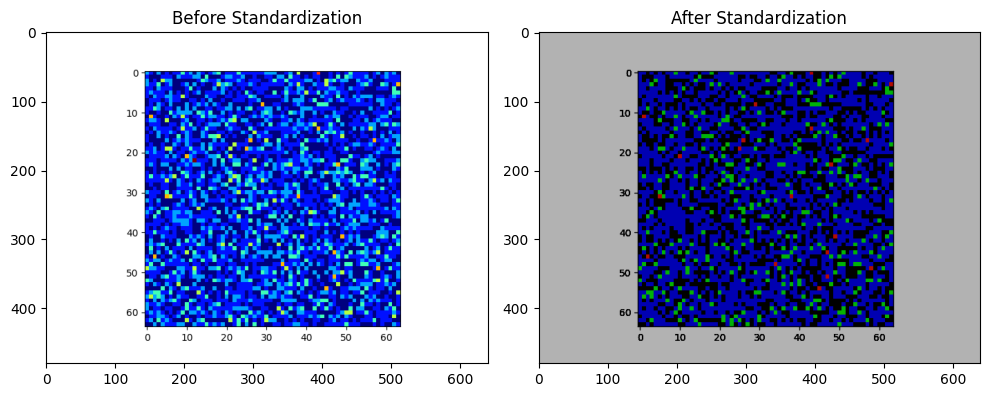

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Class: RANDOM
Before Standardization:
Mean: 179.32015625
Standard Deviation: 108.3921789095519

After Standardization:
Mean: 1.1348946473946045e-17
Standard Deviation: 1.0


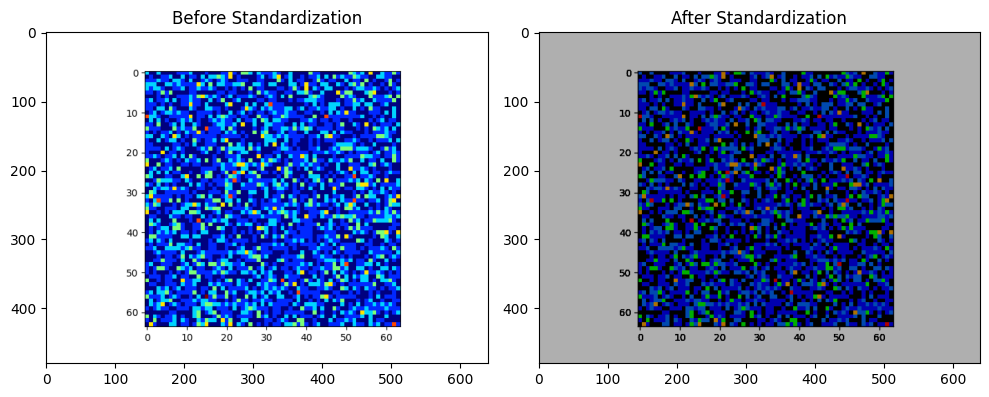

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Class: RANDOM
Before Standardization:
Mean: 181.365595703125
Standard Deviation: 106.69403275326661

After Standardization:
Mean: -5.3784137637396474e-17
Standard Deviation: 0.9999999999999996


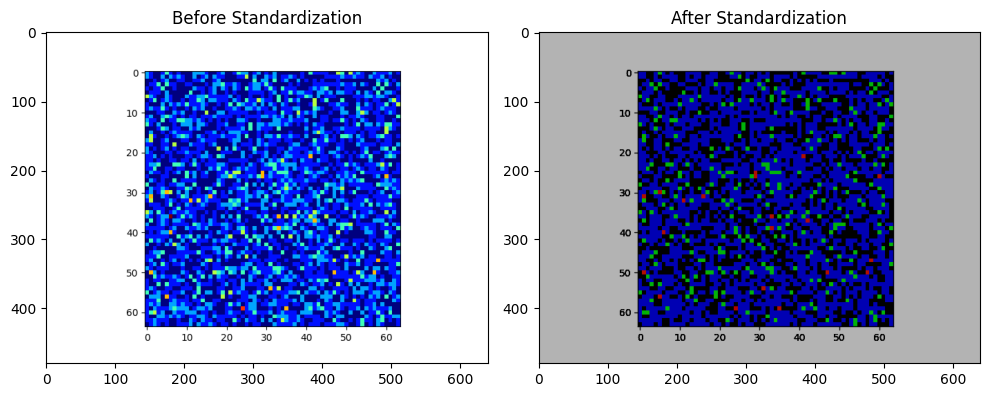

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Class: RANDOM
Before Standardization:
Mean: 178.66402994791667
Standard Deviation: 108.72562746519561

After Standardization:
Mean: 3.79942990649498e-17
Standard Deviation: 0.9999999999999994


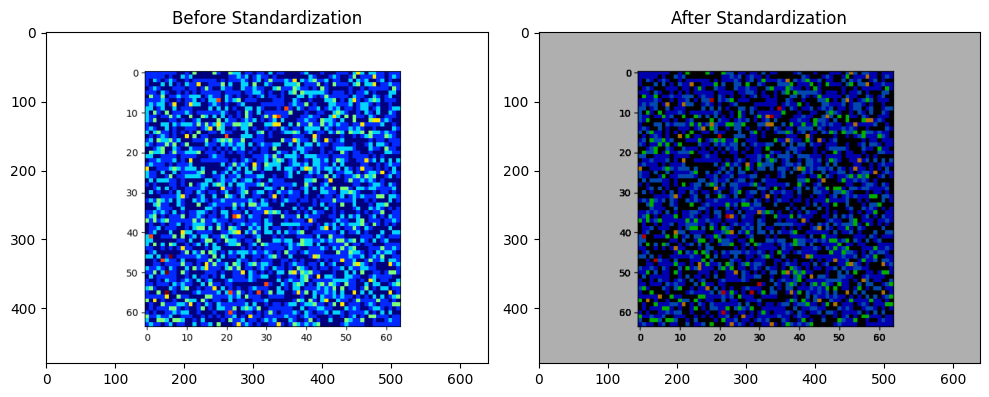

Class: RANDOM
Before Standardization:
Mean: 181.80705512152778
Standard Deviation: 106.53893800548404

After Standardization:
Mean: -2.1414968563880797e-16
Standard Deviation: 0.9999999999999999


In [148]:
# Standardize images and plot before and after
for image_path, folder in randomfourimagepath:
  image = Image.open(image_path)
  image = image.convert('RGB')
  image = np.array(image)  
  # Display before standardization
  plt.figure(figsize=(10, 4))
  plt.subplot(1, 2, 1)
  plt.imshow(image)
  plt.title('Before Standardization')
  
  standardized_image = (image - np.mean(image)) / np.std(image)

  # Display after standardization
  plt.subplot(1, 2, 2)
  plt.imshow(standardized_image)
  plt.title('After Standardization')
  plt.tight_layout()
  plt.show()
  print(f"Class: {'RANDOM'}")
  print("Before Standardization:")
  print("Mean:", np.mean(image))
  print("Standard Deviation:", np.std(image))
  print("\nAfter Standardization:")
  print("Mean:", np.mean(standardized_image))
  print("Standard Deviation:", np.std(standardized_image))
  print("="*40)


# Observation

### After standardization, , they appear less contrasted. 
#### - >The bright regions might have become less bright, and the dark regions less dark. Overall, the images woll look more uniform, with a moderate level of brightness and contrast.
#### -> technically, This adjustment ensures that the center of the pixel value distribution is at 0, which helps neural networks and algorithms work with a more balanced and centered data distribution.

### During standardizing, the pixel values are divided by the standard deviation. This scaling process makes the spread of the pixel values more consistent across the images, and the resulting standard deviation becomes close to 1. 
#### ->This helps the model to converge faster and reduces the risk of gradient exploding/vanishing during training.

## 5. ⟨ 2.5 Marks ⟩ Perform transformation on images (random rotation, random croping, random scale) and plot
before and after images.

In [149]:
# doing on the same random images rn
# first - random rotation for that performing some manipulation on the time and then 
# second - random croping dimensions resize
# third - random scale the images

In [150]:
import PIL

# Random Rotation

In [151]:
import time

def randomrotationdegree(deg):
    
    random_generator.randrange
    
    random_degree = abs(deg) % 360  # Map the value to the range [0, 360]
    
    return random_degree


In [152]:
randomtwelveindexes = []

all_indexes = list( range ( sum ( class_counts.values() ) ) )

## Choosing 12 images

In [153]:


# Choose 8 unique indexes without repetition
while len( randomtwelveindexes ) < 12 :
  
    index = random_generator.rand() % len( all_indexes )

    if index not in randomtwelveindexes:

        randomtwelveindexes.append( index )




In [154]:
randomtwelveimages = []
for randomchosenimageindexing in randomtwelveindexes:
    folder = list(class_counts.keys())[randomchosenimageindexing % len(class_counts)]
    num_files = class_counts[folder]
    if num_files > 0:
        folder_path = os.path.join(base_dir, folder)
        image_filenames = os.listdir(folder_path)
        image_filename = image_filenames[randomchosenimageindexing % num_files]
        image_path = os.path.join(folder_path, image_filename)
        randomtwelveimages.append((image_path, folder))
        

print(randomtwelveimages)


[('IMAGE_DATA/IMAGE_DATA\\AIRPLANE\\images (14).jpeg', 'AIRPLANE'), ('IMAGE_DATA/IMAGE_DATA\\ROBOTS\\images (12).jpeg', 'ROBOTS'), ('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (12).png', 'RANDOM'), ('IMAGE_DATA/IMAGE_DATA\\CARS\\images (15).jpeg', 'CARS'), ('IMAGE_DATA/IMAGE_DATA\\ELEPHANTS\\images (9).jpeg', 'ELEPHANTS'), ('IMAGE_DATA/IMAGE_DATA\\CARS\\images (6).jpeg', 'CARS'), ('IMAGE_DATA/IMAGE_DATA\\ELEPHANTS\\images (16).jpeg', 'ELEPHANTS'), ('IMAGE_DATA/IMAGE_DATA\\ROBOTS\\images (19).jpeg', 'ROBOTS'), ('IMAGE_DATA/IMAGE_DATA\\CARS\\images (10).jpeg', 'CARS'), ('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (17).png', 'RANDOM'), ('IMAGE_DATA/IMAGE_DATA\\ROBOTS\\images (4).jpeg', 'ROBOTS'), ('IMAGE_DATA/IMAGE_DATA\\AIRPLANE\\images (19).jpeg', 'AIRPLANE')]


In [155]:
from PIL import Image
import PIL
import time

## Taking random folder picture generator from above

In [156]:
store12randomangles = []

In [157]:
current_time = int(time.time()) 
seed = current_time

## Generate 12 random angles

In [158]:
# Choose 8 unique indexes without repetition
while len(store12randomangles) < 12:
    index = random_generator.rand() % 360
    if index not in store12randomangles:
        store12randomangles.append(index)


In [159]:
print(store12randomangles)

[189, 304, 255, 26, 153, 196, 339, 198, 85, 104, 287, 130]


In [160]:
indexofrotation = 0

## Plot before and after image rotation

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5D902320>
 Rotation degree is  189


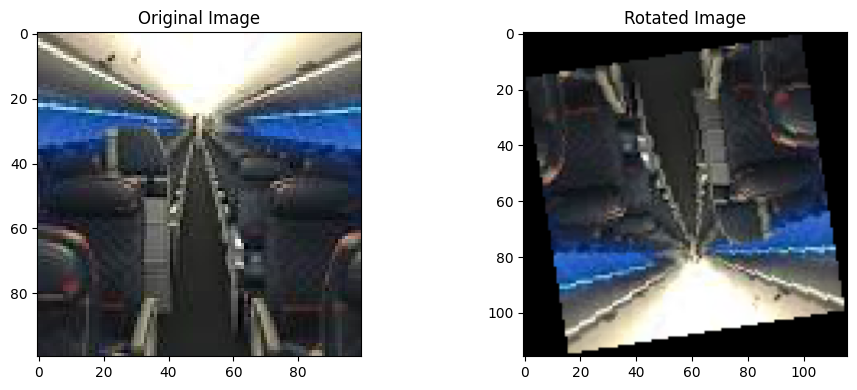

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5E5A9CF0>
 Rotation degree is  304


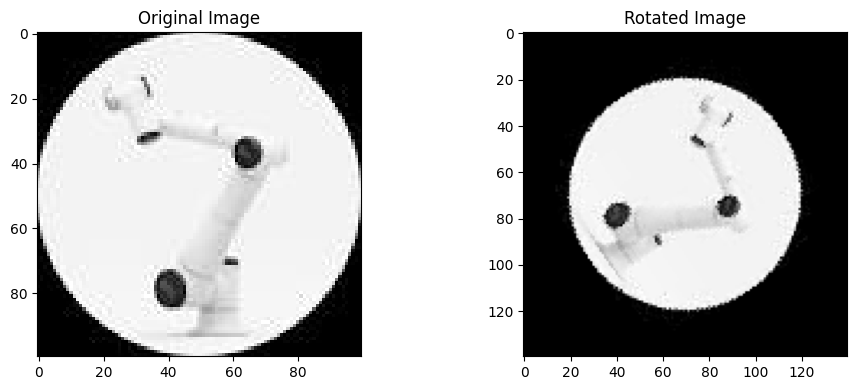

<PIL.PngImagePlugin.PngImageFile image mode=RGBA size=640x480 at 0x22B5B295090>
 Rotation degree is  255


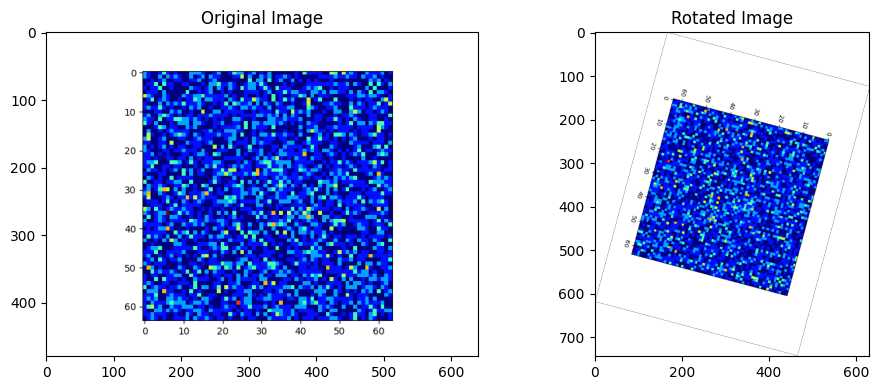

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5CDD4580>
 Rotation degree is  26


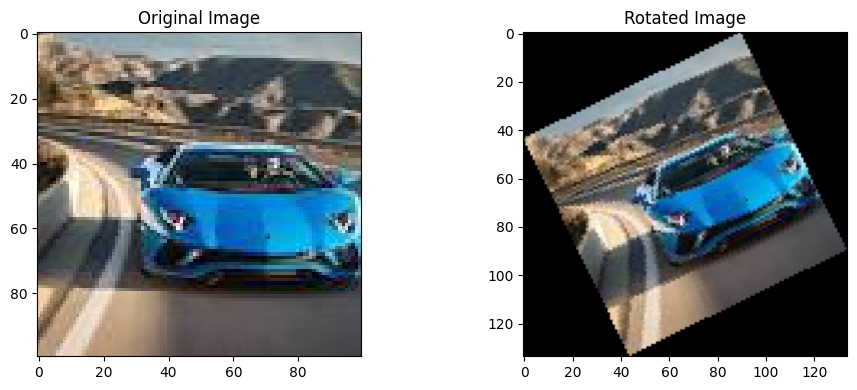

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5CB88610>
 Rotation degree is  153


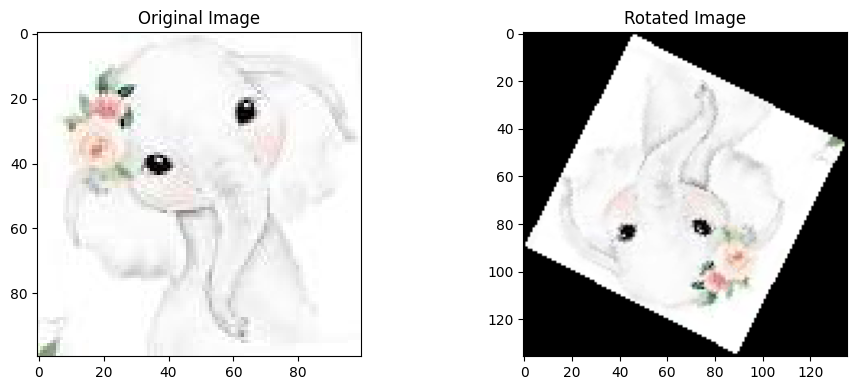

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5CD12E90>
 Rotation degree is  196


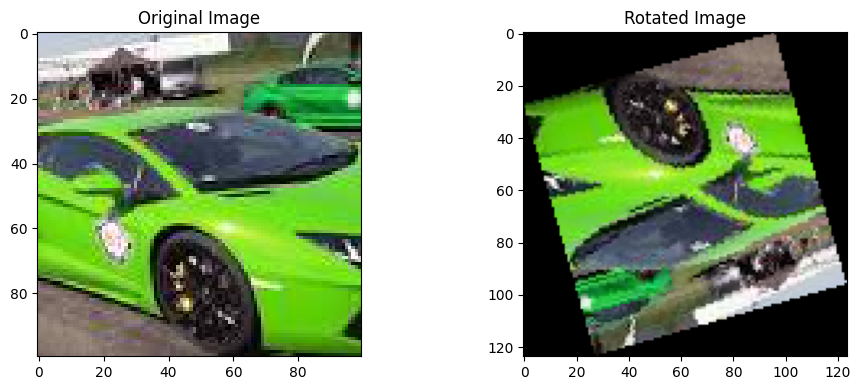

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5C459FC0>
 Rotation degree is  339


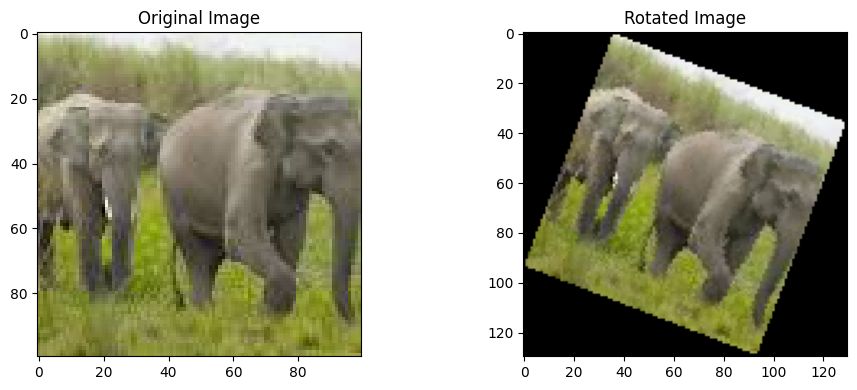

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=301x167 at 0x22B5C62B400>
 Rotation degree is  198


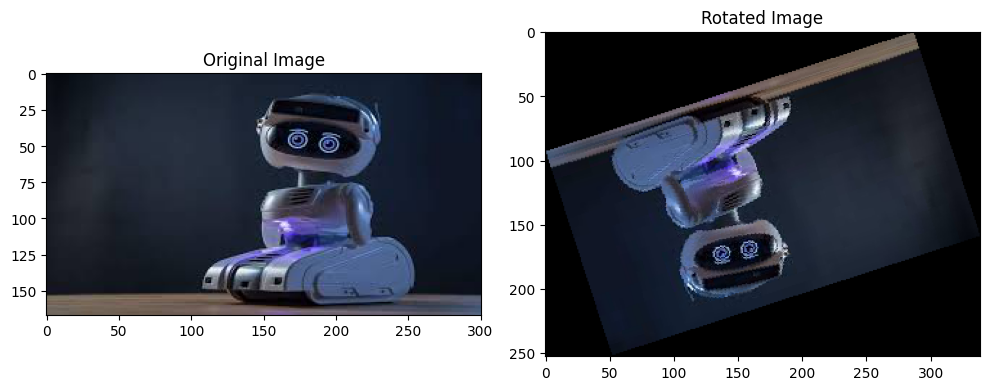

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5E5015D0>
 Rotation degree is  85


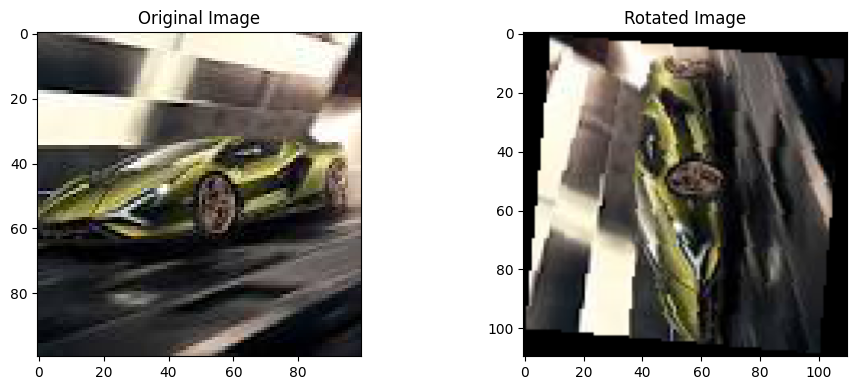

<PIL.PngImagePlugin.PngImageFile image mode=RGBA size=640x480 at 0x22B33E9F340>
 Rotation degree is  104


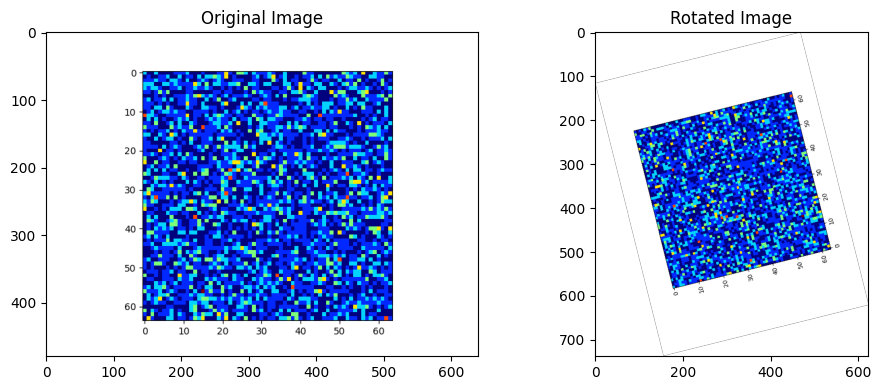

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B33E53E50>
 Rotation degree is  287


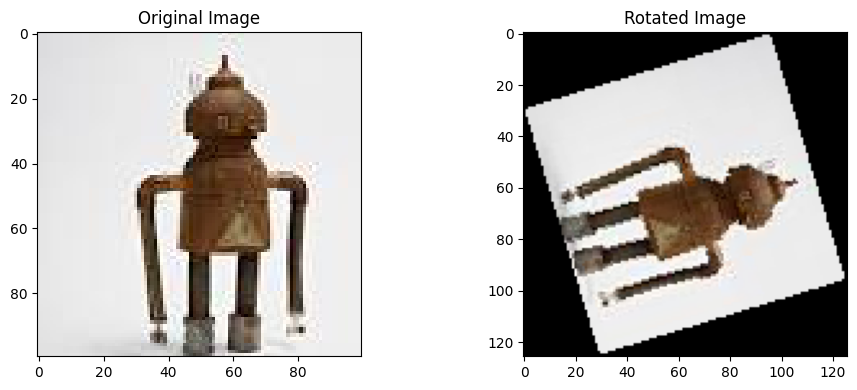

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=183x275 at 0x22B5C672C80>
 Rotation degree is  130


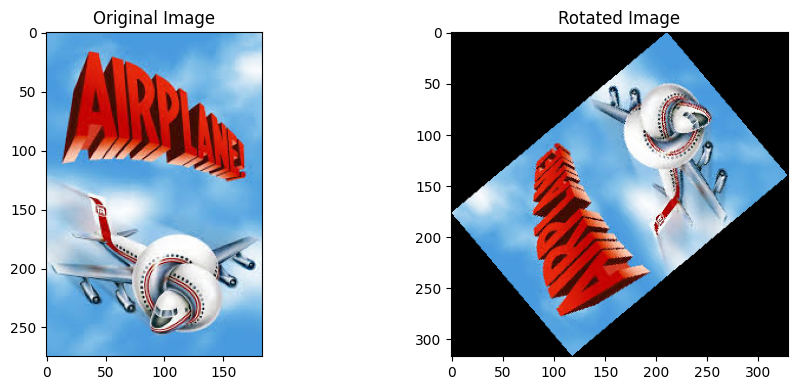

In [161]:
for image_path, folder in randomtwelveimages:
  image = Image.open(image_path)
  print(image)
  rotate_angle = store12randomangles[indexofrotation]
  indexofrotation += 1
  print( " Rotation degree is ",  rotate_angle)
  rotated_image = image.rotate( rotate_angle, PIL.Image.NEAREST, expand=1)


  # Display before and after images using Matplotlib
  plt.figure(figsize=(10, 4))
    
  # Original image
  plt.subplot(1, 2, 1)
  plt.imshow(image)
  plt.title('Original Image')
    
  # Rotated image
  plt.subplot(1, 2, 2)
  plt.imshow(rotated_image)
  plt.title('Rotated Image')
  plt.tight_layout()
  plt.show()


# Random crop image

In [162]:
store_x1 = []
store_y1 = []

## Choosing 48 dimension to crop to each images has 4 dimension and 2 images

In [163]:
setof = random_generator.generaterandomnrangeuniquenumbers( 24 , 1 , 50)
for item in setof : 
  store_x1.append(item)
print(store_x1)

[32, 7, 17, 39, 29, 24, 21, 8, 37, 18, 27, 38, 22, 10, 31, 42, 40, 19, 49, 41, 6, 13, 15, 1]


In [164]:
setof = random_generator.generaterandomnrangeuniquenumbers( 24 , 50 , 100)
for item in setof : 
  store_y1.append(item)
print(store_y1)

[74, 59, 58, 79, 88, 63, 96, 83, 82, 95, 76, 61, 52, 64, 71, 56, 65, 68, 97, 80, 51, 72, 84, 85]


In [165]:
print(randomtwelveimages)

[('IMAGE_DATA/IMAGE_DATA\\AIRPLANE\\images (14).jpeg', 'AIRPLANE'), ('IMAGE_DATA/IMAGE_DATA\\ROBOTS\\images (12).jpeg', 'ROBOTS'), ('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (12).png', 'RANDOM'), ('IMAGE_DATA/IMAGE_DATA\\CARS\\images (15).jpeg', 'CARS'), ('IMAGE_DATA/IMAGE_DATA\\ELEPHANTS\\images (9).jpeg', 'ELEPHANTS'), ('IMAGE_DATA/IMAGE_DATA\\CARS\\images (6).jpeg', 'CARS'), ('IMAGE_DATA/IMAGE_DATA\\ELEPHANTS\\images (16).jpeg', 'ELEPHANTS'), ('IMAGE_DATA/IMAGE_DATA\\ROBOTS\\images (19).jpeg', 'ROBOTS'), ('IMAGE_DATA/IMAGE_DATA\\CARS\\images (10).jpeg', 'CARS'), ('IMAGE_DATA/IMAGE_DATA\\RANDOM\\images (17).png', 'RANDOM'), ('IMAGE_DATA/IMAGE_DATA\\ROBOTS\\images (4).jpeg', 'ROBOTS'), ('IMAGE_DATA/IMAGE_DATA\\AIRPLANE\\images (19).jpeg', 'AIRPLANE')]


## Performing Random Rotation on those images and plot

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5CC474C0>
<PIL.Image.Image image mode=RGB size=42x52 at 0x22B5C672C80>


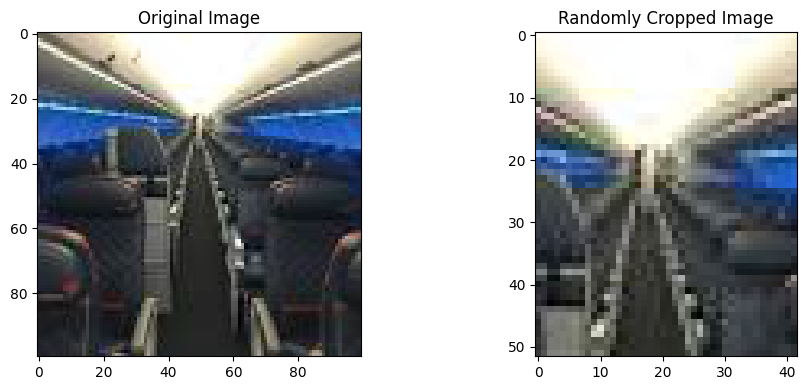

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5E472A10>
<PIL.Image.Image image mode=RGB size=41x40 at 0x22B544AA0E0>


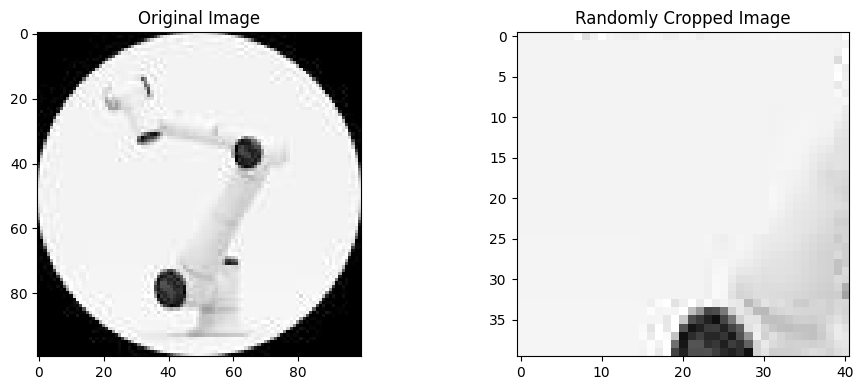

<PIL.PngImagePlugin.PngImageFile image mode=RGBA size=640x480 at 0x22B5B276200>
<PIL.Image.Image image mode=RGBA size=59x39 at 0x22B5C407F70>


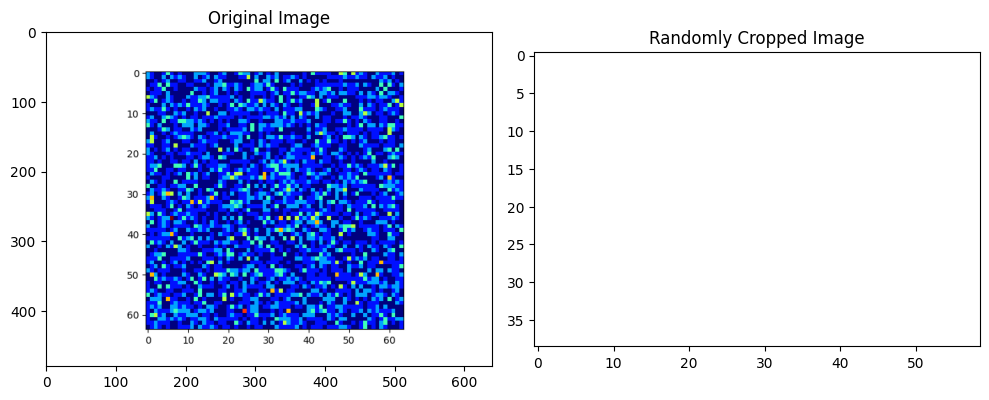

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5C2A2530>
<PIL.Image.Image image mode=RGB size=75x75 at 0x22B5B259E70>


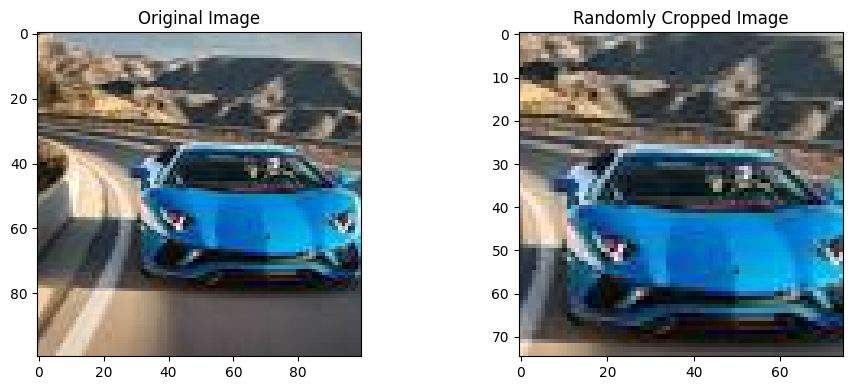

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5CC3AE30>
<PIL.Image.Image image mode=RGB size=45x77 at 0x22B5DA22230>


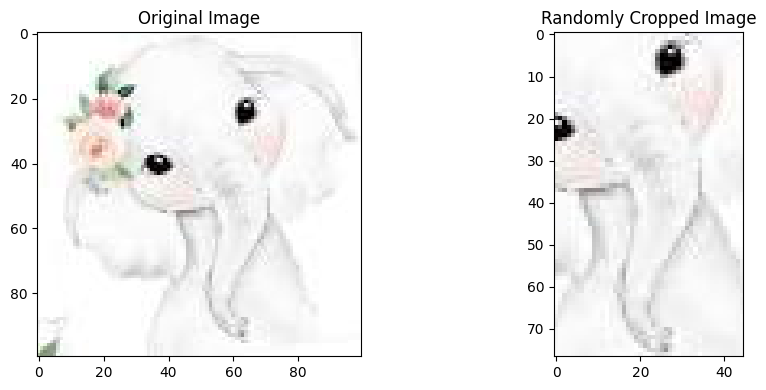

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5B234610>
<PIL.Image.Image image mode=RGB size=49x23 at 0x22B5B207CA0>


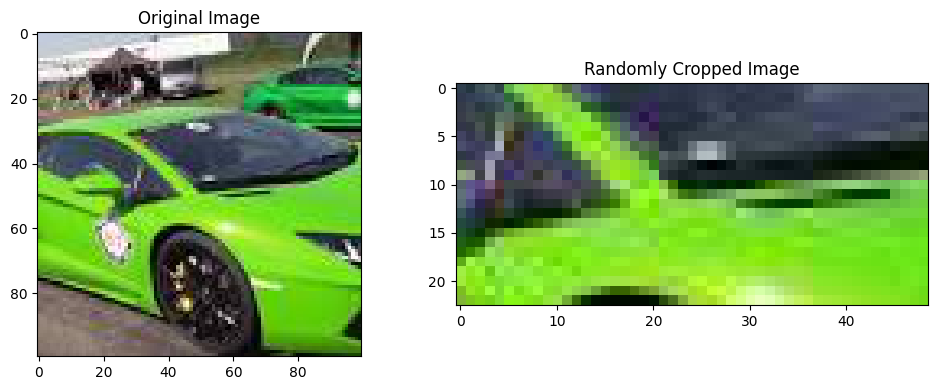

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5C3988B0>
<PIL.Image.Image image mode=RGB size=30x54 at 0x22B5C4CB820>


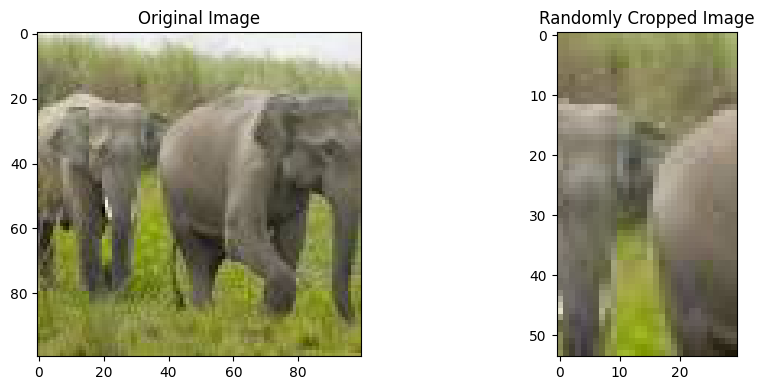

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=301x167 at 0x22B5C5F4640>
<PIL.Image.Image image mode=RGB size=40x14 at 0x22B5C4A8610>


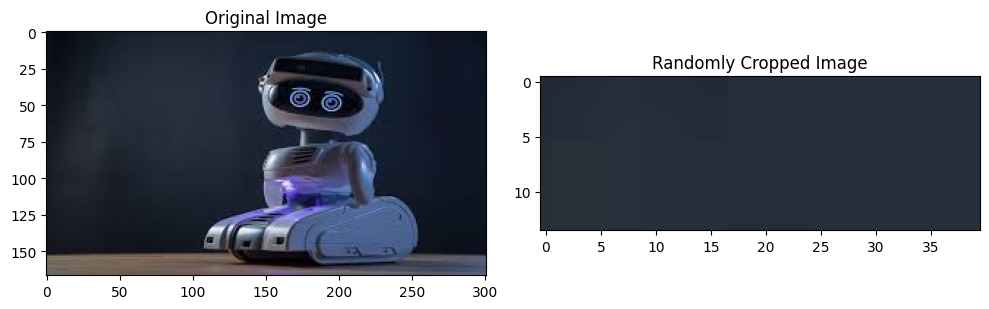

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5E6747C0>
<PIL.Image.Image image mode=RGB size=25x49 at 0x22B5C556950>


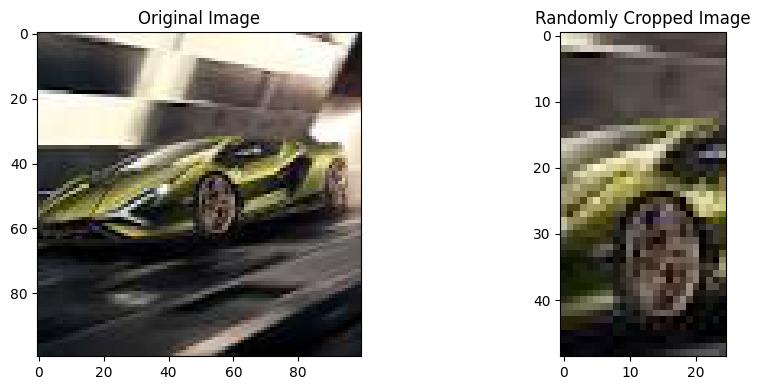

<PIL.PngImagePlugin.PngImageFile image mode=RGBA size=640x480 at 0x22B5D901090>
<PIL.Image.Image image mode=RGBA size=48x39 at 0x22B5E6747C0>


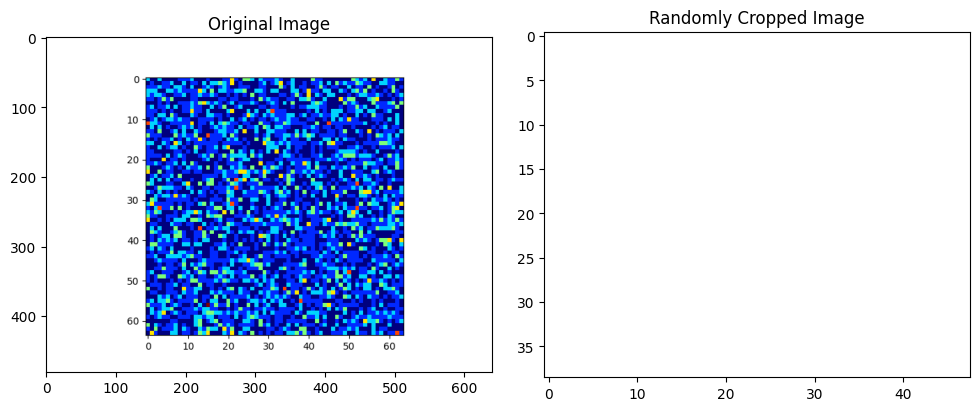

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B61744D90>
<PIL.Image.Image image mode=RGB size=45x59 at 0x22B31CD65C0>


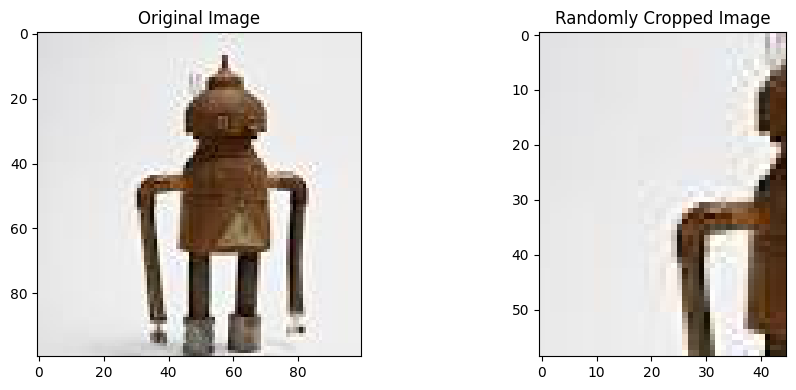

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=183x275 at 0x22B61715840>
<PIL.Image.Image image mode=RGB size=69x84 at 0x22B617442E0>


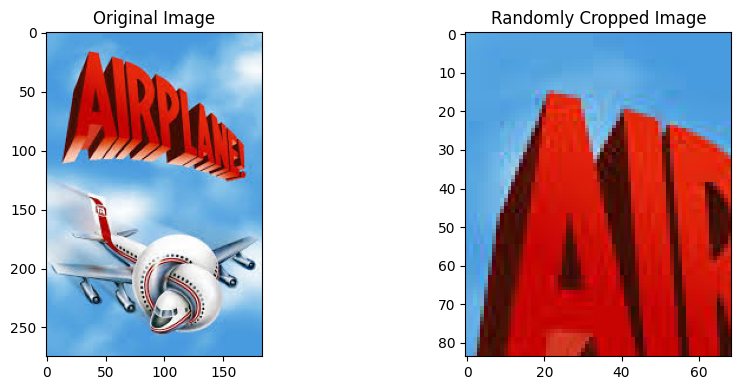

In [166]:
indexofx0 = 0
indexofx1 = 0
indexofy0 = 1
indexofy1 = 1

    
for image_path, folder in randomtwelveimages:
    image = Image.open(image_path)
    
    cropped_image = image.crop(( store_x1[indexofx0], store_x1[indexofy0] , store_y1[indexofx1], store_y1[indexofy1]))
    indexofx0 += 2
    indexofy0 += 2
    indexofx1 += 2
    indexofy1 += 2
    
    plt.figure(figsize=(10, 4))
    
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    print(image)
    plt.title('Original Image')
    
    plt.subplot(1, 2, 2)
    plt.imshow(cropped_image)
    print(cropped_image)
    plt.title('Randomly Cropped Image')
    
    plt.tight_layout()
    plt.show()
    
# Remember to ensure that the lengths of store_x1 and store_y1 match the number of images in randomtwelveimages. Also, consider how you want to handle index values that go beyond the array lengths. You might want to reset them to zero or use modulo arithmetic to loop around the arrays.


# According to google classroom, it's area so im scaling the height , which will in turn scale the area

In [167]:
generatetwelvescale = []

## 12 random scaling factors

In [168]:
# Choose 8 unique indexes without repetition
while len(generatetwelvescale) < 12:
    scale = random_generator.rand() % 30
    if scale not in store12randomangles and scale != 0:
        generatetwelvescale.append(scale) 

In [169]:
print(generatetwelvescale)

[18, 29, 14, 13, 14, 1, 2, 29, 28, 15, 4, 3]


In [170]:
def random_scale_image(image, scale_factor):
    
    new_width = int(image.width * scale_factor)
    
    return image.resize((new_width, image.height))


In [171]:
scaleindex = 0

## Scaling and seeing before and after images

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5E675420>
scaling factor is  18
<PIL.Image.Image image mode=RGB size=1800x100 at 0x22B61715840>


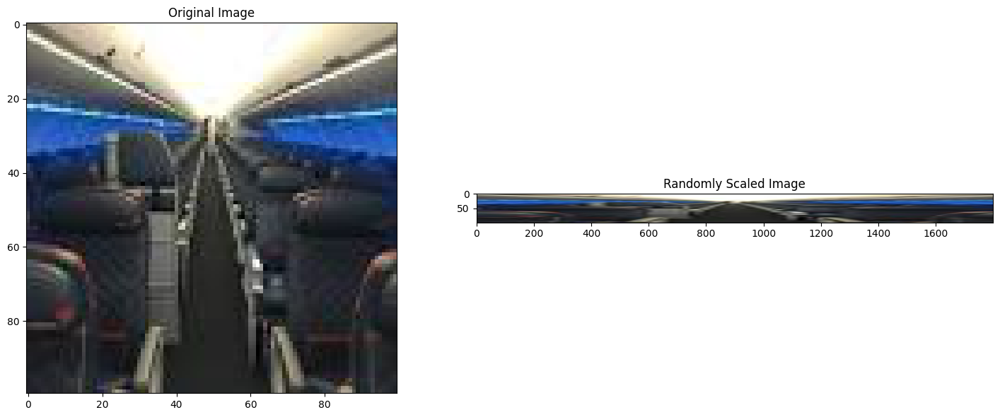

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5C3B3CA0>
scaling factor is  29
<PIL.Image.Image image mode=RGB size=2900x100 at 0x22B5E675420>


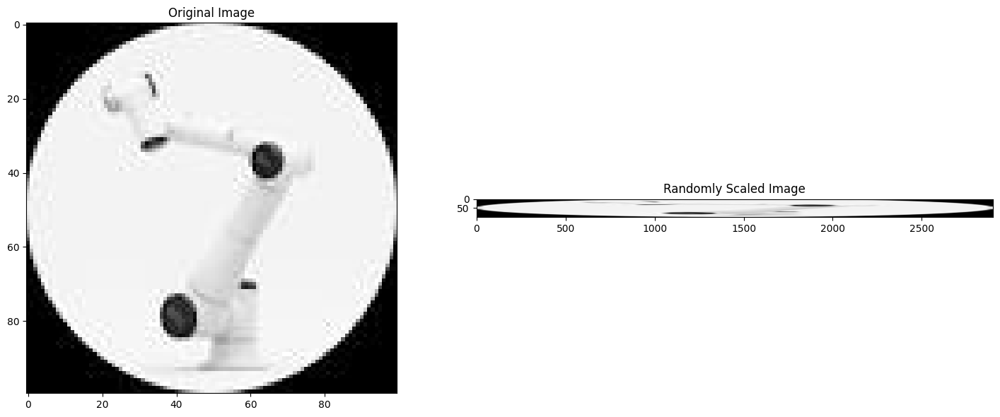

<PIL.PngImagePlugin.PngImageFile image mode=RGBA size=640x480 at 0x22B5B204E20>
scaling factor is  14
<PIL.Image.Image image mode=RGBA size=8960x480 at 0x22B5C470DC0>


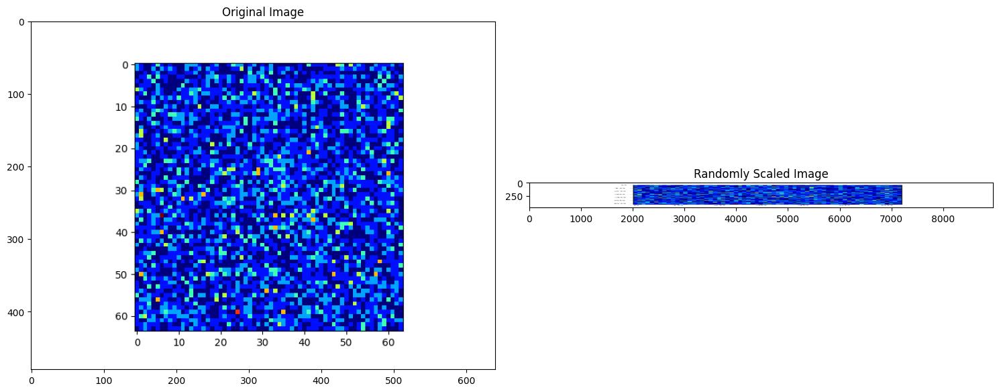

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5B236CE0>
scaling factor is  13
<PIL.Image.Image image mode=RGB size=1300x100 at 0x22B5B204E20>


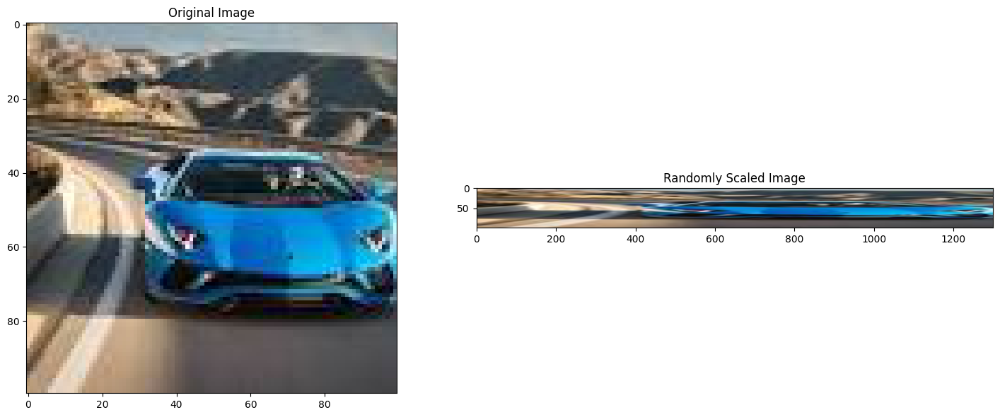

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5CDB0B80>
scaling factor is  14
<PIL.Image.Image image mode=RGB size=1400x100 at 0x22B5B236CE0>


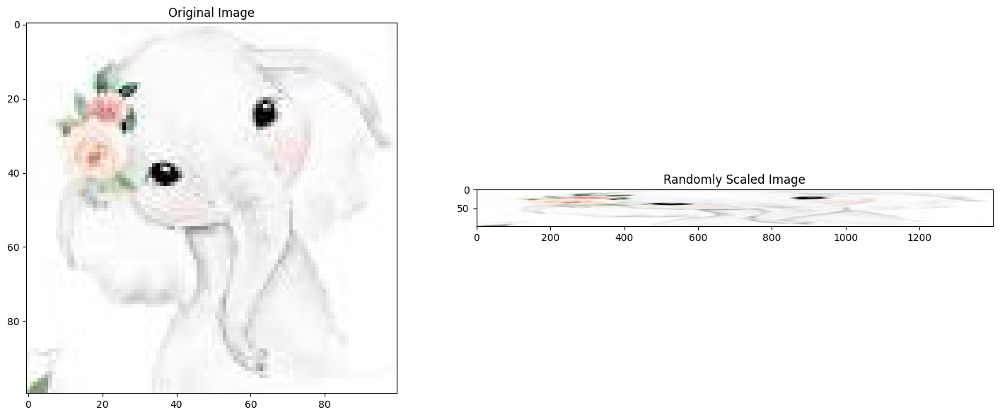

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B2F3C7700>
scaling factor is  1
<PIL.Image.Image image mode=RGB size=100x100 at 0x22B5CDB0B80>


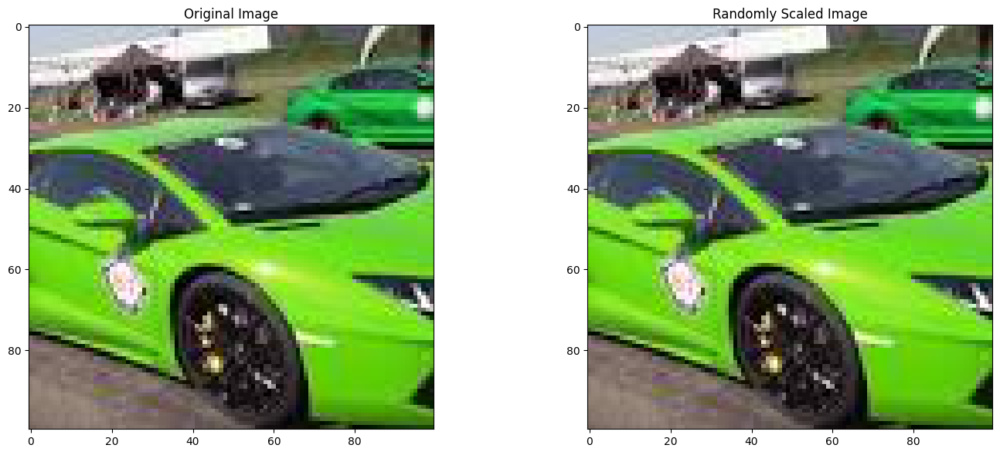

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5CDD4C70>
scaling factor is  2
<PIL.Image.Image image mode=RGB size=200x100 at 0x22B2F3C7700>


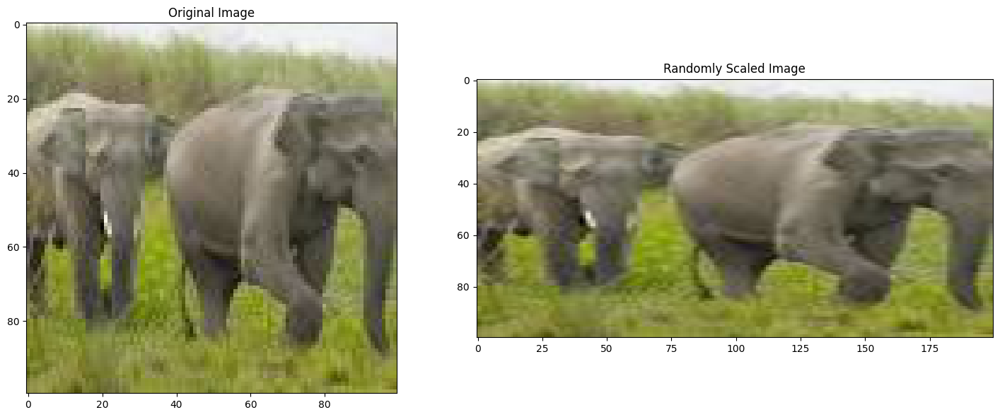

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=301x167 at 0x22B5B2A4310>
scaling factor is  29
<PIL.Image.Image image mode=RGB size=8729x167 at 0x22B5CDD4C70>


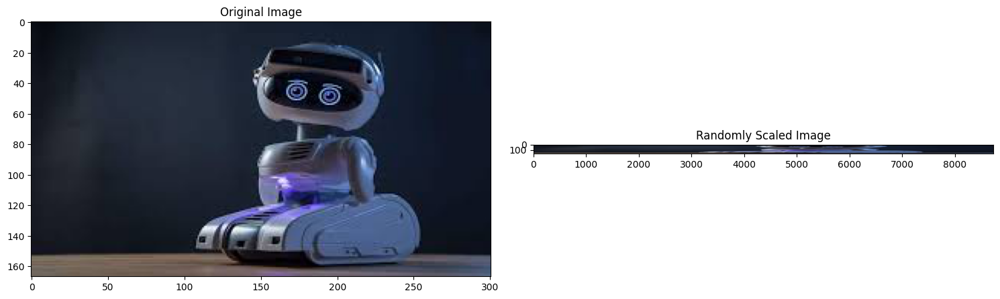

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5CC32500>
scaling factor is  28
<PIL.Image.Image image mode=RGB size=2800x100 at 0x22B5B2A4310>


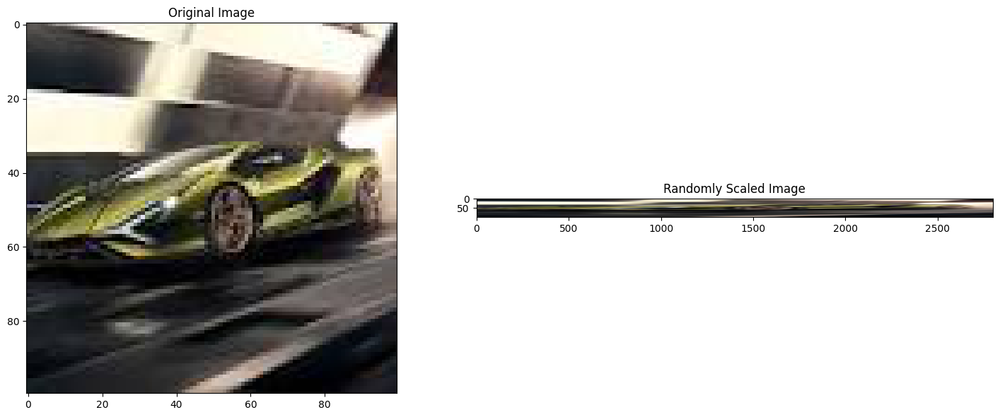

<PIL.PngImagePlugin.PngImageFile image mode=RGBA size=640x480 at 0x22B5C672890>
scaling factor is  15
<PIL.Image.Image image mode=RGBA size=9600x480 at 0x22B33E7EC50>


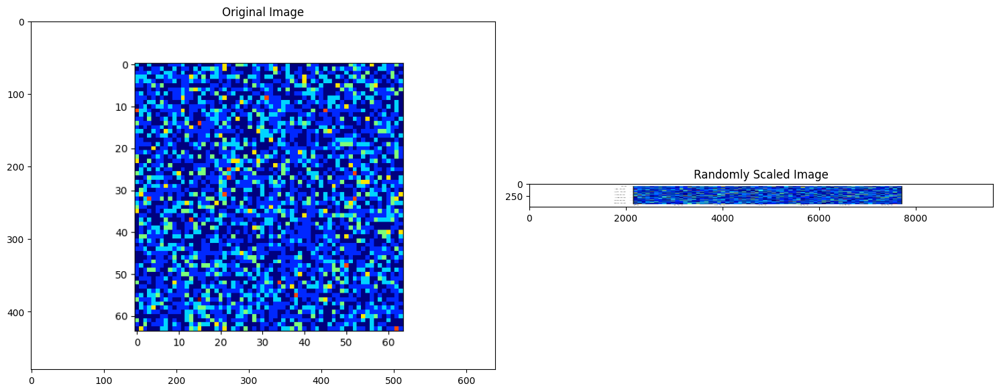

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=100x100 at 0x22B5E503400>
scaling factor is  4
<PIL.Image.Image image mode=RGB size=400x100 at 0x22B5C672890>


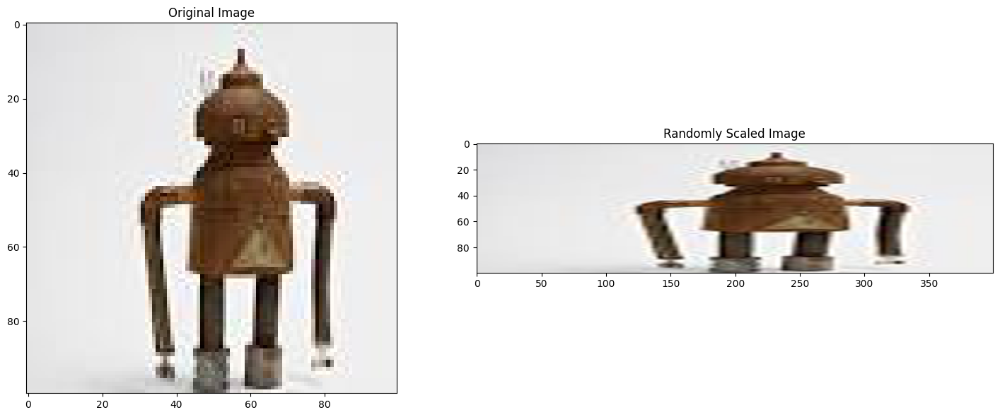

<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=183x275 at 0x22B5C4583A0>
scaling factor is  3
<PIL.Image.Image image mode=RGB size=549x275 at 0x22B5E503400>


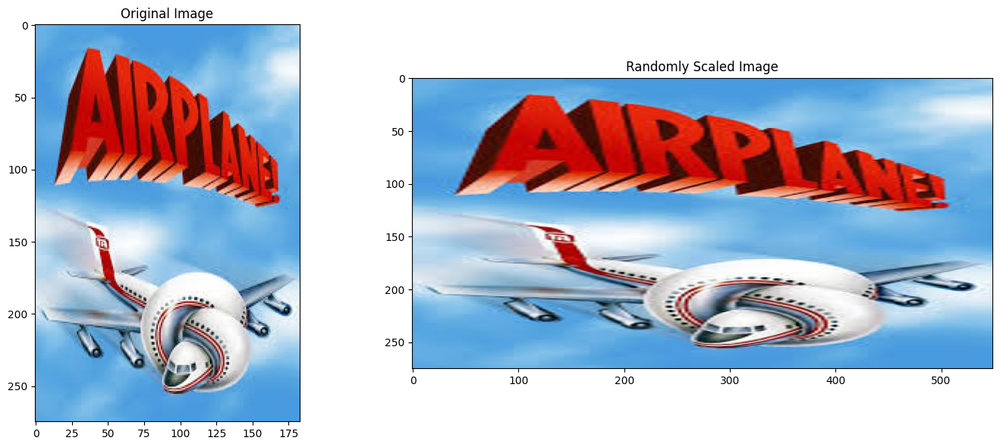

In [172]:
for image_path, folder in randomtwelveimages:
    image = Image.open(image_path)
    
    scaled_image = random_scale_image(image , generatetwelvescale[scaleindex])
    
    
    plt.figure(figsize=(15, 6))
    
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title('Original Image')
    print(image)
    print("scaling factor is ", generatetwelvescale[scaleindex])
    scaleindex += 1
    plt.subplot(1, 2, 2)
    plt.imshow(scaled_image)
    print(scaled_image)
    plt.title('Randomly Scaled Image')
    
    plt.tight_layout()
    plt.show()


## TEXT DATA

### QUESTION 1. ⟨ 2 Marks ⟩ Find average text length of English and Hindi corpus (exluding whitespace, punctuations etc.)

In [173]:
import pandas as pd
import time
import re


In [174]:
def calculateaverageoftextsentences(sentences):
    validsentences = [sentence for sentence in sentences if isinstance(sentence, str)]
    totallength = sum(len(sentence) for sentence in validsentences)
    averagelength = totallength / len(validsentences)
    return averagelength
 

In [175]:
csvfilepath = 'TEXT_DATA/TEXT_DATA/Hindi_English_parallel.csv'

In [176]:
# Read the CSV file using pandas
data = pd.read_csv(csvfilepath)


In [177]:
# Calculate the average text length for English sentences

averagelengthenglish = calculateaverageoftextsentences(data['english_sentence'])
print("len of englis is " , len(data['english_sentence']) ) 
# Calculate the average text length for Hindi sentences
averagelengthhindi = calculateaverageoftextsentences(data['hindi_sentence'])
print("len of hindi is " , len(data['hindi_sentence']) ) 


len of englis is  177606
len of hindi is  177606


In [178]:
# doing upto 2 decimal digits
print(f"Average text length of English corpus: {averagelengthenglish:.2f} characters") 
print(f"Average text length of Hindi corpus: {averagelengthhindi:.2f} characters")


Average text length of English corpus: 89.61 characters
Average text length of Hindi corpus: 86.28 characters


## 2. ⟨ 2 Marks ⟩ Randomly select 20 parallel texts and remove puctuations and special characters.

In [179]:
x = len(data['english_sentence'])

In [180]:
# choose random 20 lines
chooseindexes=[]

In [181]:
for i in range(20):
  choosenindex = random_generator.rand() % x
  if choosenindex not in chooseindexes:
    chooseindexes.append(choosenindex)

In [182]:
print(chooseindexes)

[15172, 48545, 135528, 112669, 129834, 37633, 136, 18311, 171216, 125889, 58554, 154275, 138336, 7959, 152380, 133397, 58620, 111821, 96050, 173209]


# Code for English removal of characters

In [183]:
def removespecialcharactersfromenglish(text):
    cleaned_text = re.sub(r'[^a-zA-Z0-9\s]', '', text)  # Remove non-alphanumeric characters
    cleaned_text = cleaned_text.replace(',', '')  # Remove commas
    # cleaned_text = cleaned_text.replace(' ', '')  # Remove commas
    return cleaned_text

# Code for Hindi removal of characters

In [184]:
def removespecialcharactersfromhindi(text):
    cleaned_text = re.sub(r'[^\s\u0900-\u097F]', '', text)  # Remove non-Hindi characters
    cleaned_text = cleaned_text.replace(',', '')  # Remove commas
    cleaned_text = cleaned_text.replace('।', '')  # Remove vertical bars
    return cleaned_text

In [185]:
# Process and print the selected lines without special characters and commas
for index in chooseindexes:
    english_line = data['english_sentence'][index]
    hindi_line = data['hindi_sentence'][index]

    # Remove special characters and punctuation
    cleaned_english_line = removespecialcharactersfromenglish(english_line)
    cleaned_hindi_line = removespecialcharactersfromhindi(hindi_line)

    print(f"Line {index + 1} - English: {cleaned_english_line}")
    print(f"Line {index + 1} - Hindi: {cleaned_hindi_line}")

Line 15173 - English: In fact legend has is that when Doubting Thomas the Apostle Saint Thomas
Line 15173 - Hindi: यहाँ तक की यह भी कहा जाता है की देवदूत के शक करने पर संत थोमस
Line 48546 - English: These tombs make us see the entire construction of Tajmahal
Line 48546 - Hindi: यह मीनारें ताजमहल की बनावट की सममितीय प्रवृत्ति दर्शित करतीं हैं
Line 135529 - English: By the regular consumption of orange one can be saved from common cold  running nose  cough  influenza  bleeding etc 
Line 135529 - Hindi: संतरे का नियमित सेवन करने से सामान्य सर्दी  जुकाम  खाँसी  इन्फ्लूएन्जा  रक्तस्राव आदि से बचाव होता है 
Line 112670 - English: We want to clear out all the stagnant pools and let in clean fresh water everywhere 
Line 112670 - Hindi: हम उन जगहों को साफ कर देना चाहते हैं  जहां पानी ठहर गया है और यह चाहते हैं कि सभी जगह साफ और ताजा पानी आता रहे 
Line 129835 - English: No matter how advanced or clever the computer is  it does only that work whose process we are aware of and which we have made t

## 3. ⟨ 2 Marks ⟩ Randomly select 50 parallel texts and make dictionary for both english and hindi corpus. (Here dictionary means a key-value mapping where key is word and value is a unique number, no two keys can have same number)

In [186]:
chooseindexes=[]

In [187]:
for i in range(50):
  choosenindex = random_generator.rand() % x
  if choosenindex not in chooseindexes:
    chooseindexes.append(choosenindex)

In [188]:
print(chooseindexes)

[3648, 137551, 66084, 15103, 86856, 165735, 106068, 114671, 32638, 93355, 43052, 34305, 136728, 78765, 83366, 64847, 74290, 68155, 90308, 128041, 10586, 170995, 9876, 85419, 48540, 146167, 41342, 152229, 48482, 86377, 95216, 164355, 9232, 41441, 50004, 155663, 55606, 50925, 71012, 35789, 175008, 88083, 73996, 48481, 113524, 130627, 121512, 126623, 5310, 96399]


print(chooseindexes)

In [189]:
# Process the selected lines and populate dictionaries
englishindex = 0
englishdictionary = {}


# Making English Dictionary

In [190]:
englishindex = 0
englishdictionary = {}

for index in chooseindexes:
    englishline = data['english_sentence'][index].split(' ')
    for word in englishline:
        # Convert the word to lowercase to ensure case-insensitive uniqueness
        lowercase_word = word.lower()
        
        # Check if the lowercase_word is not in the dictionary
        if lowercase_word not in englishdictionary:
            englishdictionary[lowercase_word] = englishindex
            englishindex += 1


In [191]:
hindidictionary = {}
hindiindex = 0

In [192]:
# Print the dictionaries
print("English Dictionary:")
print(englishdictionary)

English Dictionary:
{'as': 0, 'per': 1, 'some': 2, 'people': 3, 'by': 4, 'blessings': 5, 'of': 6, 'jagatguru': 7, 'ramanand': 8, 'swami': 9, 'he': 10, 'had': 11, 'born': 12, 'from': 13, 'the': 14, 'womb': 15, 'a': 16, 'widow': 17, 'brahmin': 18, 'lady': 19, 'in': 20, 'kashi.': 21, 'she': 22, 'says': 23, 'that': 24, 'way': 25, 'there': 26, 'is': 27, 'reaction': 28, 'on': 29, 'skin': 30, 'use': 31, 'artifical': 32, 'products': 33, ',': 34, 'same': 35, 'could': 36, 'be': 37, 'harmful': 38, 'made': 39, 'up': 40, 'herbs': 41, '.': 42, 'sanjay': 43, 'gandhi': 44, 'national': 45, 'park': 46, 'situated': 47, 'near': 48, 'city.': 49, 'buildings': 50, 'are': 51, 'now': 52, 'ruins': 53, 'and': 54, 'lot': 55, 'vegetation': 56, 'creepers': 57, 'have': 58, 'entwined': 59, 'walls': 60, 'setting': 61, 'different': 62, 'artistic': 63, 'geometrical': 64, 'patterns': 65, 'which': 66, 'make': 67, 'place': 68, 'romantic': 69, 'perhaps': 70, 'why': 71, 'her': 72, 'real': 73, 'elevation': 74, 'to': 75, 'stat

## Making Hindi Dictionry

In [193]:
for index in chooseindexes:
    hindi_line = data['hindi_sentence'][index]
    hindi_words = re.findall(r'\w+', hindi_line)
    
    for word in hindi_words:
        if word not in hindidictionary:
            hindidictionary[word] = hindiindex
            hindiindex += 1

In [194]:
print("Hindi Dictionary")
print(hindidictionary)

Hindi Dictionary
{'क': 0, 'छ': 1, 'ल': 2, 'ग': 3, 'अन': 4, 'स': 5, 'र': 6, 'व': 7, 'जगद': 8, 'म': 9, 'नन': 10, 'द': 11, 'आश': 12, 'श': 13, 'एक': 14, 'धव': 15, 'ब': 16, 'ह': 17, 'मण': 18, 'गर': 19, 'भ': 20, 'उत': 21, 'पन': 22, 'न': 23, 'ए': 24, 'थ': 25, 'अपन': 26, 'प': 27, 'शहन': 28, 'ज': 29, 'ट': 30, 'नह': 31, 'त': 32, 'जय': 33, 'ध': 34, 'ष': 35, 'य': 36, 'उद': 37, 'नगर': 38, 'सम': 39, 'इस': 40, 'रक': 41, 'जकड': 42, 'उन': 43, 'पर': 44, 'कल': 45, 'मक': 46, 'तथ': 47, 'नम': 48, 'बन': 49, 'गए': 50, 'वरण': 51, 'कह': 52, 'डर': 53, 'वन': 54, 'यद': 55, 'यह': 56, 'वजह': 57, 'तव': 58, 'मरण': 59, 'अवत': 60, 'अध': 61, 'इत': 62, 'गय': 63, 'तक': 64, 'च': 65, 'नज': 66, 'आम': 67, 'और': 68, 'हम': 69, 'गत': 70, 'लत': 71, 'रय': 72, 'उस': 73, 'पह': 74, 'करत': 75, 'कर': 76, 'जरत': 77, 'वह': 78, 'सड': 79, 'इन': 80, 'झ': 81, 'गद': 82, 'अपश': 83, 'गढ': 84, 'ड': 85, 'भर': 86, 'आ': 87, 'ख': 88, 'सकत': 89, 'फ': 90, 'बदब': 91, 'पक': 92, 'आग': 93, 'ई': 94, 'फर': 95, 'पड': 96, 'तन': 97, 'बज': 98, 'शक': 99, 'थक': 10

## 4. ⟨ 2 Marks ⟩ Find 10 most occuring words and plot there histogram with labels.

In [195]:
def mostusedenglishwords( englishwords ):
  englishwordcounts = {} 
  for word in englishwords:
    # Exclude words with special characters using regex pattern
    if re.match(r'^[a-zA-Z]+$', word):
      if word in englishwordcounts:
        englishwordcounts[word] += 1
      else:
        englishwordcounts[word] = 1
  return englishwordcounts


In [196]:
def mostusedhindiwords ( hindiwords ):
  hindiwordcounts = {}
  for word in hindiwords:
    # Exclude words with special characters using regex pattern
    if re.match(r'[ऀ-ॿ]+', word) and word != '।' :
      if word in hindiwordcounts:
        hindiwordcounts[word] += 1
      else:
        hindiwordcounts[word] = 1
  return hindiwordcounts

In [197]:
from matplotlib.font_manager import FontProperties

In [198]:

data = data.dropna(subset=['english_sentence', 'hindi_sentence']) # drop words with NaN value
englishwords = ' '.join(data['english_sentence']).lower().split() # make it lower case , split as per space


# Most used english words

In [199]:
englishwordcounts = mostusedenglishwords(englishwords)
mostcommonenglishwords = sorted(englishwordcounts.items(), key=lambda x: x[1], reverse=True)[:10]
print(mostcommonenglishwords)

[('the', 181100), ('of', 115874), ('and', 76915), ('in', 71418), ('to', 60852), ('is', 49923), ('a', 47440), ('that', 22511), ('this', 21955), ('for', 21397)]


# Most Used Hindi Words

In [200]:
hindiwords = ' '.join(data['hindi_sentence']).lower().split()
hindiwordcounts = mostusedhindiwords( hindiwords)

# Get the 10 most common Hindi words and their counts we sort and then reverse for the requirment
mostcommonhindiwords = sorted(hindiwordcounts.items(), key=lambda x: x[1], reverse=True)[:10]
print( mostcommonhindiwords)

[('के', 118023), ('में', 89619), ('है', 83617), ('की', 68188), ('से', 57771), ('और', 57480), ('का', 47280), ('को', 42386), ('हैं', 33673), ('पर', 27677)]


# Plot Histogram

In [201]:
def plot_histogram(commontenwordsforplot, language, font_path=None):
    words, counts = zip(*commontenwordsforplot)
    plt.figure(figsize=(10, 6))
    plt.bar(words, counts)
    plt.xlabel('Words')
    plt.ylabel('Frequency')
    plt.title(f'Most Common Words in {language} Sentences')

    if font_path:
        custom_font = FontProperties(fname=font_path)
        plt.xticks(fontproperties=custom_font)

    plt.tight_layout()
    plt.show()



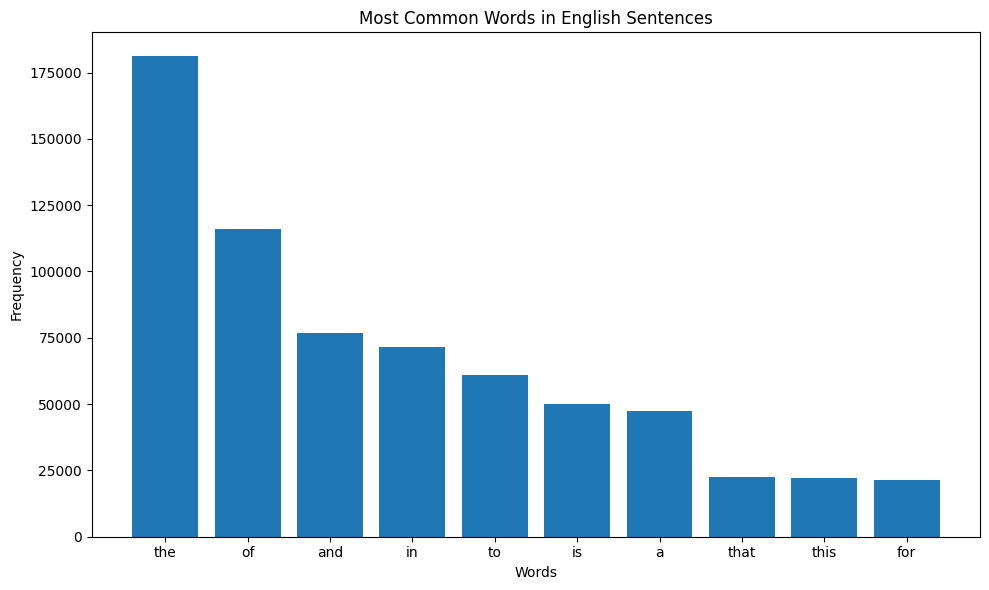

C:\Users\Chief Engineer (C)\AppData\Local\Temp\ipykernel_2304\2112577067.py:13: UserWarning: Glyph 108 (l) missing from current font.
  plt.tight_layout()
C:\Users\Chief Engineer (C)\AppData\Local\Temp\ipykernel_2304\2112577067.py:13: UserWarning: Glyph 112 (p) missing from current font.
  plt.tight_layout()
c:\Users\Chief Engineer (C)\anaconda3\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 108 (l) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
c:\Users\Chief Engineer (C)\anaconda3\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 112 (p) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


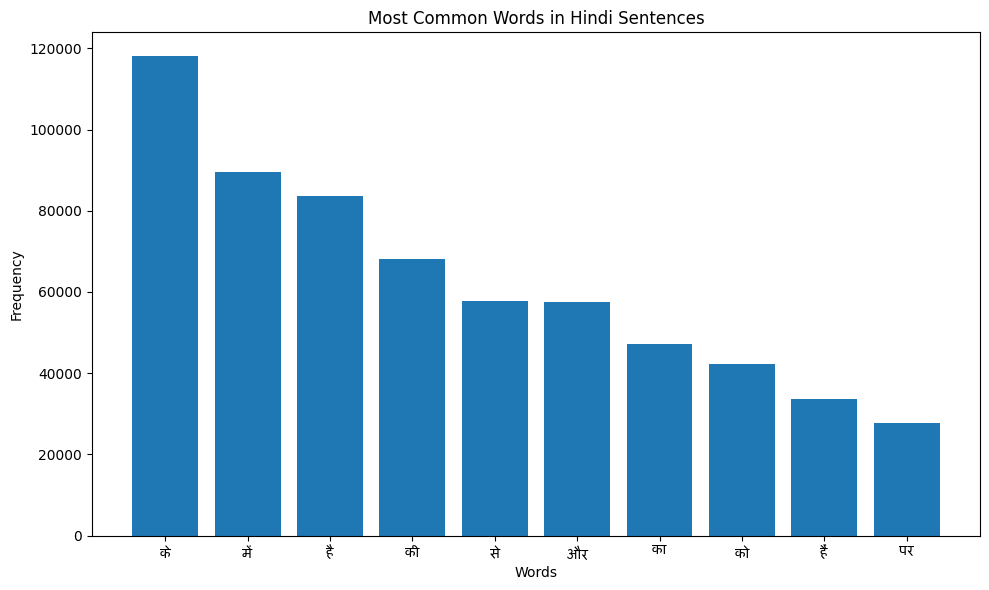

In [202]:
font_path = r'Mangal400.ttf'
plot_histogram(mostcommonenglishwords, 'English')
plot_histogram(mostcommonhindiwords, 'Hindi',font_path )




## AUDIO DATA

###  1. ⟨ 2 Marks ⟩ Find mean audio length of each class and check for imbalance class if any, suggest methods to balance the dataset.

## All the libraries used below are

In [203]:
import os
import librosa
import matplotlib.pyplot as plt
import numpy as np
import time
import librosa.display
import soundfile as sf
from scipy.io import wavfile
import IPython.display as ipd 
from IPython.display import Audio, display
import librosa.display


### 1. ⟨ 2 Marks ⟩ Find mean audio length of each class and check for imbalance class if any, suggest methods to balance the dataset.

In [204]:
base_dir = 'AUDIO_DATA/AUDIO_DATA'
directoryoffolders = os.listdir(base_dir)
class_lengths = {}

## Finding mean and total audio

In [205]:
for classnumber in directoryoffolders:

    folder_path = os.path.join(base_dir, classnumber)

    if os.path.isdir(folder_path):
        audiolengths = []

        for audiofile in os.listdir(folder_path):

            if audiofile.lower().endswith('.wav') or audiofile.lower().endswith('.mp3'):

                audiopath = os.path.join(folder_path, audiofile)
                audiofileinarray , samplingrateofaudio  = librosa.load(audiopath)
                audiolength = librosa.get_duration( y = audiofileinarray , sr = samplingrateofaudio )
                audiolengths.append(audiolength)
        
        if audiolengths: # to check if we are not dividing by 0 in case
            class_lengths[classnumber] = len(audiolengths)
            print("Total number of audio files in " , classnumber , " is " , len(audiolengths) , " and total audio length is " , sum(audiolengths)  )
            meanaudiolength = sum(audiolengths) / len(audiolengths)
            print(f"{classnumber}: Mean Audio Length = {meanaudiolength:.2f} seconds")


Total number of audio files in  CLASS 1  is  10  and total audio length is  219.73219954648528
CLASS 1: Mean Audio Length = 21.97 seconds
Total number of audio files in  CLASS 2  is  10  and total audio length is  18.874739229024943
CLASS 2: Mean Audio Length = 1.89 seconds


Total number of audio files in  CLASS 3  is  16  and total audio length is  792.5159637188209
CLASS 3: Mean Audio Length = 49.53 seconds
Total number of audio files in  CLASS 4  is  10  and total audio length is  21.691201814058957
CLASS 4: Mean Audio Length = 2.17 seconds
Total number of audio files in  CLASS 5  is  10  and total audio length is  23.024353741496604
CLASS 5: Mean Audio Length = 2.30 seconds


##### There are 16 audio files in class 3 so it's unbalanced ( too much as compared to all other files with 10 audio files)
##### As per the total audio , length in a folder Class 3 is outlier

In [206]:
import math
class_counts = {}


In [207]:
class_counts_values = np.array(list(class_lengths.values()))
mean = np.mean(class_counts_values)
variance = np.var(class_counts_values)
std_deviation = math.sqrt(variance)  
# can change the threshold as per the data and preference
threshold = 2
outliers = {}


In [208]:
# Find outliers using Gaussian distribution
for cls, count in class_lengths.items(): 
    z_score = (count - mean) / std_deviation
    if abs(z_score) >= threshold:
        outliers[cls] = z_score
if( len(outliers) > 0):
    print(" Imbalanced dataset")

print("Outliers (class z-scores):", outliers)

 Imbalanced dataset
Outliers (class z-scores): {'CLASS 3': 2.0000000000000004}


##### There are 16 audio files in class 3 so it's unbalanced ( too much as compared to all other files with 10 audio files)
##### As per the total audio , length in a folder Class 3 is outlier 
##### One method is to undersample Class 3 to range of other classes ( Class 3 majorly) [preferable in this cass]
##### Other is to create more samples ( Oversample ) the other class namely  class 1, class 2, class 4, class 5 [ in terms of total audio length]

### 2. ⟨ 2 Marks ⟩ Plot spectrogram of randomly selected 4 audios from complete dataset.

In [209]:
randomfouraudios= [] 

In [210]:
class_counts = len(directoryoffolders)

## 4 random audios

In [211]:

for randomaudioindex in range(4):
    
    folder = list(class_lengths.keys())[random_generator.rand()% len(class_lengths.keys())]
    print(folder)
    
    num_files = class_lengths[folder]  # Assuming class g_lengths is a dictionary
    print(num_files)
    
    random_audio = random_generator.randrange(0, num_files - 1)
    
    folder_path = os.path.join(base_dir, folder)
    audio_filenames = os.listdir(folder_path)
    audio_filename = audio_filenames[random_audio]
    
    image_path = os.path.join(folder_path, audio_filename)
    randomfouraudios.append((image_path, folder))  # Store both image path and folder name



CLASS 5
10
CLASS 3
16
CLASS 3
16
CLASS 4
10


In [212]:
for x in randomfouraudios:
    print(x)


('AUDIO_DATA/AUDIO_DATA\\CLASS 5\\M08_B3_LH_M2.wav', 'CLASS 5')
('AUDIO_DATA/AUDIO_DATA\\CLASS 3\\dramatic-background-music-for-short-videos-1-minute-little-alicia-155718.mp3', 'CLASS 3')
('AUDIO_DATA/AUDIO_DATA\\CLASS 3\\0341.wav', 'CLASS 3')
('AUDIO_DATA/AUDIO_DATA\\CLASS 4\\M08_B1_CW10_M2.wav', 'CLASS 4')


In [213]:
for aud,folder in randomfouraudios: 
  print(aud)
  display(Audio(aud))

AUDIO_DATA/AUDIO_DATA\CLASS 5\M08_B3_LH_M2.wav


AUDIO_DATA/AUDIO_DATA\CLASS 3\dramatic-background-music-for-short-videos-1-minute-little-alicia-155718.mp3


AUDIO_DATA/AUDIO_DATA\CLASS 3\0341.wav


AUDIO_DATA/AUDIO_DATA\CLASS 4\M08_B1_CW10_M2.wav


In [214]:
frameSize = 2000
hopSize = 20


In [215]:
def plotspectrogram(y, sr, hop_length, y_axis = "linear"):
    plt.figure(figsize = (25,10))
    librosa.display.specshow(y, sr = sr, hop_length = hop_length, x_axis = "time", y_axis = y_axis)
    plt.colorbar(format="%+2.f")


(1001, 1930)


(1001, 112551)
(1001, 3122)
(1001, 1722)


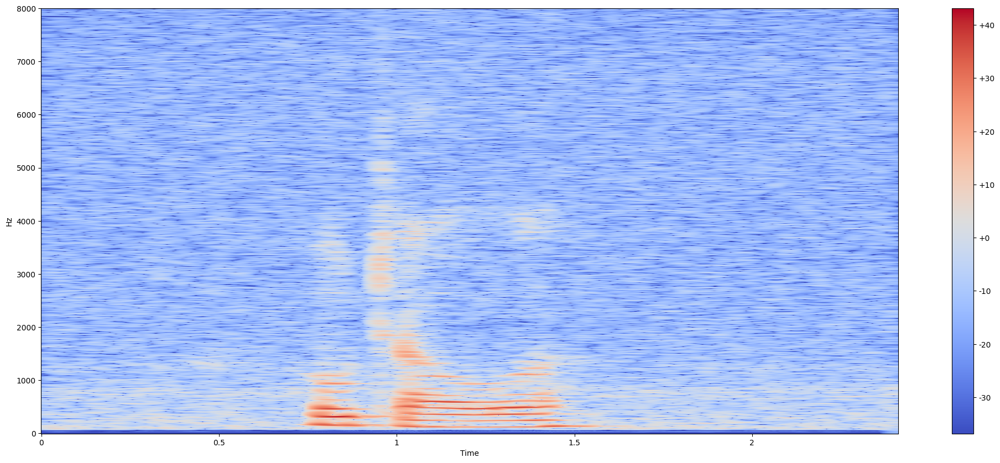

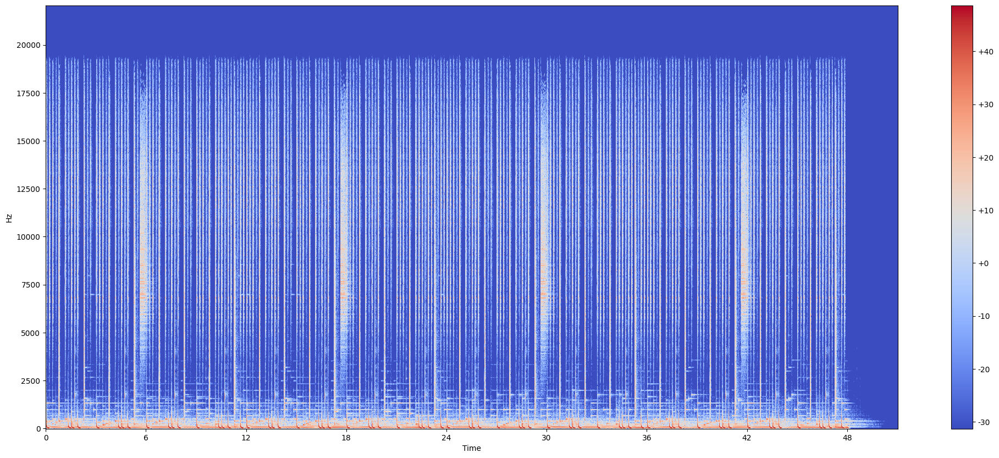

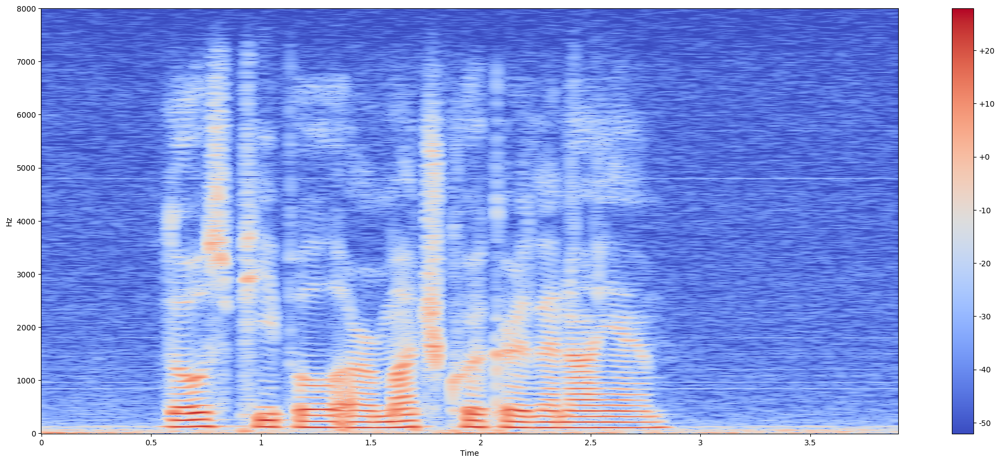

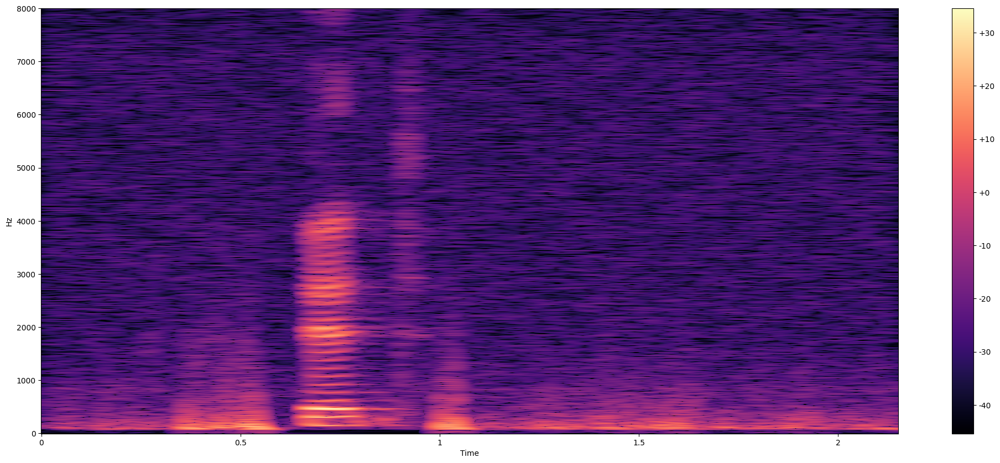

In [216]:
for aud,folder in randomfouraudios: 
  y, sr = librosa.load(aud, sr=None)  # Load audio file , it makes array of audio
    # print(y)

  stft_audio = librosa.stft(y, n_fft=frameSize, hop_length=hopSize)
  # print(stft_audio.shape)
  y_audio = np.abs(stft_audio) ** 2
  y_audio.shape

  y_log_audio = librosa.power_to_db(y_audio)
  # print(y_log_audio)
  plotspectrogram(y_log_audio, sr , hopSize)

  print(y_audio.shape)


## 3. ⟨ 2 Marks ⟩ Implement Pre-Emphasis filter from scratch and plot before and after time-domain plots of ran-


###  Pre-emphasis filter boosts the high-frequency components of an audio signal by emphasizing the differences between consecutive samples. 
### Its doing this new pre-emphasized signal: y_pre_emphasized[n+1] = y[n+1] + (y[n+1] - pre_emphasis_coefficient * y[n])

### The filter enhances high-frequency details, improves the signal-to-noise ratio, and makes subsequent processing steps, like compression and analysis, more effective.
### It's often used in audio processing to enhance the clarity and quality of the signal, particularly for applications like speech recognition.



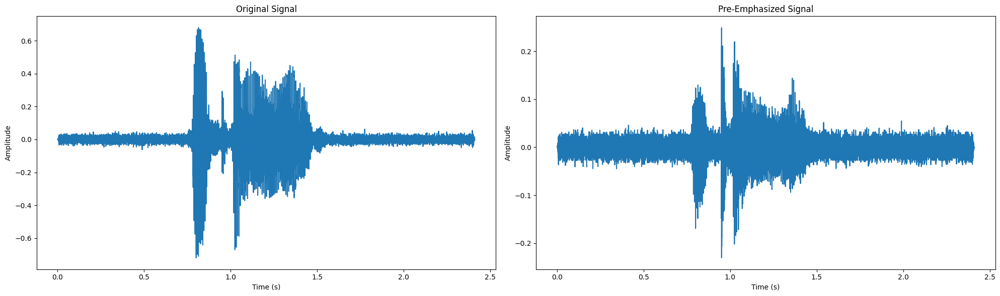

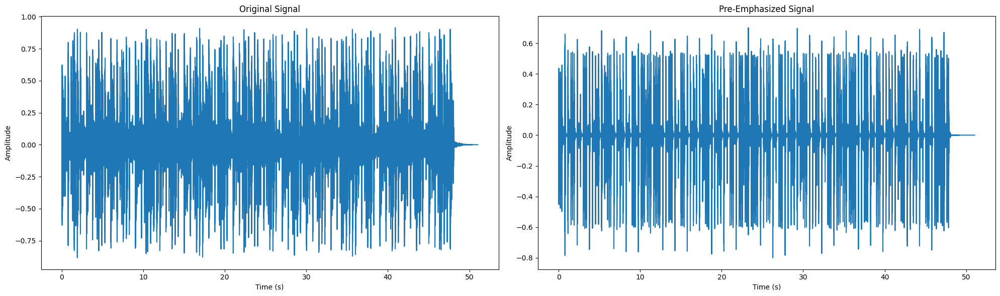

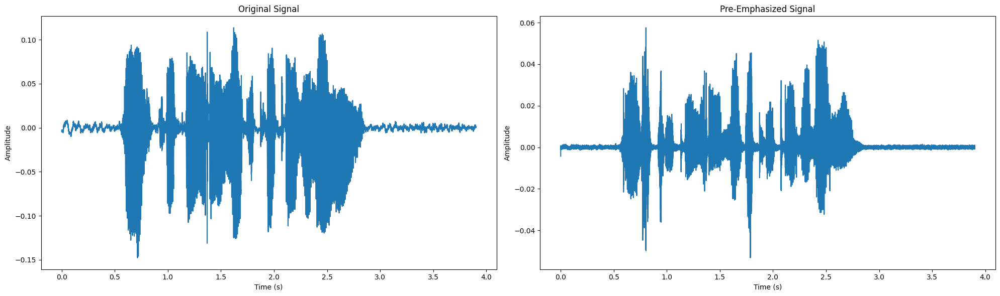

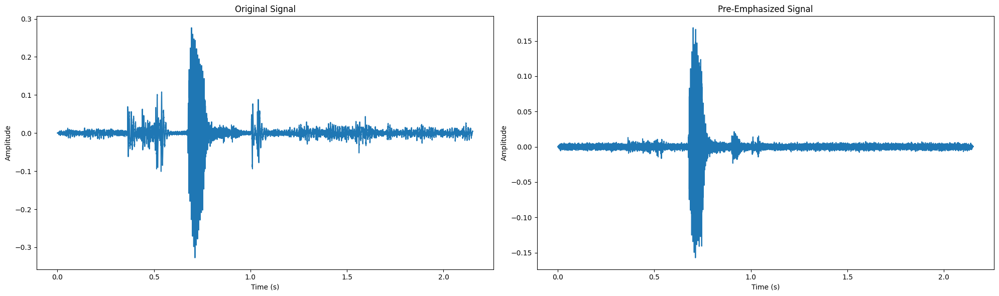

In [217]:

# Assuming 'randomfouraudios' contains the paths to the audio files
for aud,folder in randomfouraudios:
    # Load audio file

    ybeforepreemphasis, sr = librosa.load(aud, sr=None)
       
    # Define the pre-emphasis filter coefficient (usually around 0.95)
    preemphasisfiltercoefficent = 0.95
    
    # Apply pre-emphasis filter
    yafterpreemphasis = np.append(ybeforepreemphasis[0], ybeforepreemphasis[1:] - preemphasisfiltercoefficent * ybeforepreemphasis[:-1])
    


    # Plot original and pre-emphasized signals
    plt.figure(figsize=(20, 6))
    
    # Original signal
    plt.subplot(1, 2, 1)
    plt.plot(np.arange(len(ybeforepreemphasis)) / sr, ybeforepreemphasis )
    plt.title('Original Signal')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    
    # Pre-emphasized signal
    plt.subplot(1, 2, 2)
    plt.plot(np.arange(len(yafterpreemphasis)) / sr, yafterpreemphasis)
    plt.title('Pre-Emphasized Signal')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    
    plt.tight_layout()
    plt.show()


## 4. ⟨ 2.5 Marks ⟩ Perform upsampling and downsampling of audio named speech-librivox-0053.wav in CLASS 1 and plot before and after spectrograms, write your observations.

## Load the audio file above

In [218]:
filelocation = 'CLASS 1/speech-librivox-0053.wav'
audiolocation = os.path.join(base_dir, filelocation)


In [219]:
print(audiolocation)
display(Audio(audiolocation))

AUDIO_DATA/AUDIO_DATA\CLASS 1/speech-librivox-0053.wav


### Preprocess it

In [220]:
audiofileinarray , samplingrateofaudio  = librosa.load(audiolocation)
audiolength = librosa.get_duration( y = audiofileinarray , sr = samplingrateofaudio )
print(audiolength)

205.06126984126985


In [221]:
audio_data, sr = librosa.load(audiolocation, sr=None)
print(audio_data)
print("sampling rate is ", sr)

[ 0.0000000e+00  0.0000000e+00  0.0000000e+00 ...  0.0000000e+00
 -3.0517578e-05  0.0000000e+00]
sampling rate is  16000


## Original Spectogram

C:\Users\Chief Engineer (C)\AppData\Local\Temp\ipykernel_2304\1263242229.py:6: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  spec_original = librosa.amplitude_to_db(librosa.stft(audio_data), ref=np.max)


Text(0.5, 1.0, 'Original Spectrogram')

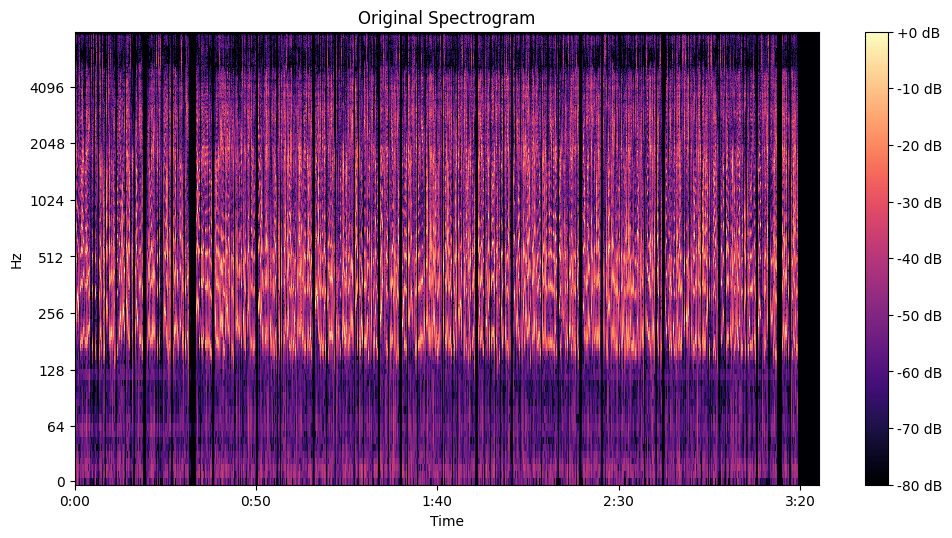

In [222]:
# Plot the original spectrogram
plt.figure(figsize=(12, 20))

plt.subplot(3, 1, 1)

spec_original = librosa.amplitude_to_db(librosa.stft(audio_data), ref=np.max)
librosa.display.specshow(spec_original, sr=sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Original Spectrogram')



In [223]:
print(spec_original)

[[-80. -80. -80. ... -80. -80. -80.]
 [-80. -80. -80. ... -80. -80. -80.]
 [-80. -80. -80. ... -80. -80. -80.]
 ...
 [-80. -80. -80. ... -80. -80. -80.]
 [-80. -80. -80. ... -80. -80. -80.]
 [-80. -80. -80. ... -80. -80. -80.]]


### Upsampling the data by factor of 10 

In [224]:
# Upsample the audio data
upsampled_sr = sr * 10  # Adjust the upsampling factor as needed
audio_data_upsampled = librosa.resample(audio_data, orig_sr=sr, target_sr=upsampled_sr)

### Display the spectogram after changes

## Upsample Spectogram

C:\Users\Chief Engineer (C)\AppData\Local\Temp\ipykernel_2304\3741299453.py:5: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  spec_upsampled = librosa.amplitude_to_db(librosa.stft(audio_data_upsampled), ref=np.max)


Text(0.5, 1.0, 'Spectrogram after Upsampling')

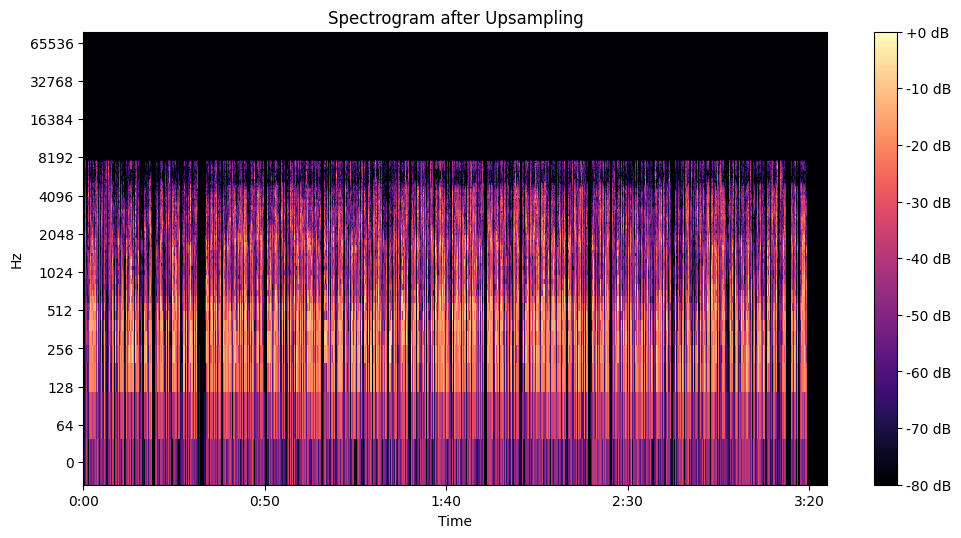

In [225]:

# Plot the spectrogram after upsampling
plt.figure(figsize=(12, 20))

plt.subplot(3, 1, 2)
spec_upsampled = librosa.amplitude_to_db(librosa.stft(audio_data_upsampled), ref=np.max)
librosa.display.specshow(spec_upsampled, sr=upsampled_sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram after Upsampling')


In [226]:
print(spec_upsampled)

[[-80. -80. -80. ... -80. -80. -80.]
 [-80. -80. -80. ... -80. -80. -80.]
 [-80. -80. -80. ... -80. -80. -80.]
 ...
 [-80. -80. -80. ... -80. -80. -80.]
 [-80. -80. -80. ... -80. -80. -80.]
 [-80. -80. -80. ... -80. -80. -80.]]


## Downsample the dataa

In [227]:


# Downsample the audio data
downsampled_sr = sr // 10  # Adjust the downsampling factor as needed
audio_data_downsampled = librosa.resample(audio_data, orig_sr=sr, target_sr=downsampled_sr)



In [228]:
print(audio_data_downsampled)

[-4.4402722e-07  5.0308527e-06 -1.0497333e-06 ... -3.8519647e-06
  1.2757095e-05  4.1048238e-06]


### Make the spectogram

C:\Users\Chief Engineer (C)\AppData\Local\Temp\ipykernel_2304\3177991057.py:5: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  spec_downsampled = librosa.amplitude_to_db(librosa.stft(audio_data_downsampled), ref=np.max)


Text(0.5, 1.0, 'Spectrogram after Downsampling')

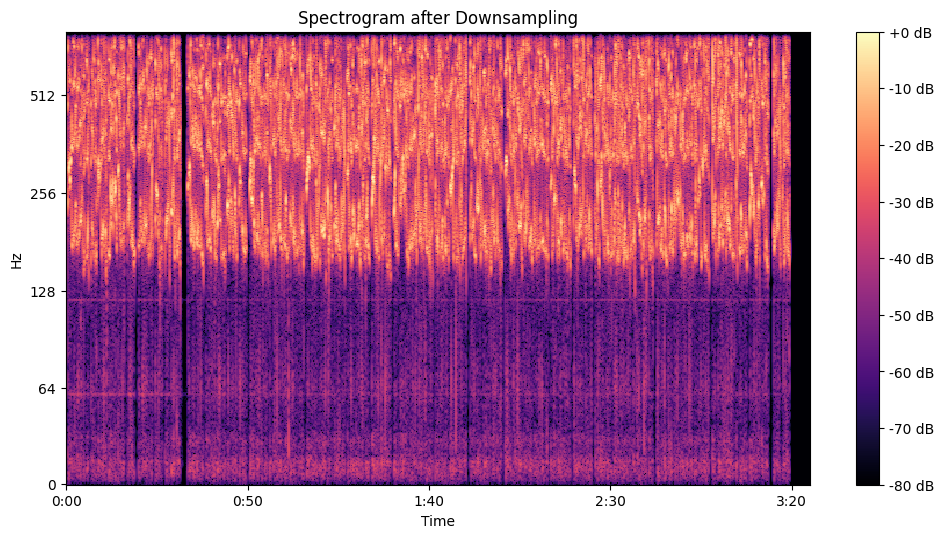

In [229]:

# Plot the spectrogram after downsampling
plt.figure(figsize=(12, 20))

plt.subplot(3, 1, 3)
spec_downsampled = librosa.amplitude_to_db(librosa.stft(audio_data_downsampled), ref=np.max)
librosa.display.specshow(spec_downsampled, sr=downsampled_sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram after Downsampling')

### Displaying downsampled spectogram

# Observation
### After upsampling,the frequency resolution of the spectrogram increases, which lsead to more detailed frequency components being visible. This can make the spectrogram appear more "spread out" in terms of frequency.

# After downsampling, the frequency resolution of the spectrogram decreases.The finer frequency details are lost, which makes the spectrogram appear more "compressed" in terms of frequency.



##### Chunked audio in all three formats on disk, then load it and compare spectrogram of all 3 formats.

In [230]:
audiopath = ''

In [231]:

folder = list(class_lengths.keys())[random_generator.rand()% len(class_lengths.keys())]
print(folder)
    

CLASS 1


In [232]:
num_files = class_lengths[folder]  # Assuming class_lengths is a dictionary
print(num_files)

10


In [233]:
random_audio = random_generator.randrange(0, num_files - 1)


In [234]:
folder_path = os.path.join(base_dir, folder)
audio_filenames = os.listdir(folder_path)
audio_filename = audio_filenames[random_audio]


In [235]:
    
audio_path = os.path.join(folder_path, audio_filename)
print(audio_path)

AUDIO_DATA/AUDIO_DATA\CLASS 1\0011.wav


In [236]:
audiofileinarray, samplingrateofaudio = librosa.load(audio_path)


In [237]:

# Get the length of the audio in seconds
audiolength = librosa.get_duration(y=audiofileinarray, sr=samplingrateofaudio)

print("Audio Length:", audiolength, "seconds")



Audio Length: 1.526077097505669 seconds


In [238]:

# Load audio file using librosa
audiofileinarray, samplingrateofaudio = librosa.load(audio_path)


In [239]:
# Get the length of the audio in seconds
audiolength = librosa.get_duration(y=audiofileinarray, sr=samplingrateofaudio)
print("Audio Length:", audiolength, "seconds")


Audio Length: 1.526077097505669 seconds


# Correction of number of seconds of that random audio

In [240]:

# Calculate the length of the audio in seconds
length_s = len(audiofileinarray) / float(samplingrateofaudio)
# print(length_s)

if length_s < 2.00:
  audiofileinarray1 = np.zeros(int((2 - length_s) * samplingrateofaudio))
  audiofileinarray2 = np.append(audiofileinarray, audiofileinarray1)
elif length_s > 2.00:
  num_samples_to_remove = int((length_s - 2.0) * samplingrateofaudio)
  audiofileinarray2 = audiofileinarray[:-num_samples_to_remove]
else:
  print('Audio file duration is 2 seconds')
  audiofileinarray2 = audiofileinarray





In [241]:
# Convert processed_audio to suitable format (int16)
processed_audio_int16 = (audiofileinarray2 * 32767).astype(np.int16)



In [242]:

# Get the length of the processed audio in seconds
processed_audiolength = len(audiofileinarray2) / samplingrateofaudio


In [243]:
print("Processed Audio Length:", processed_audiolength, "seconds")

print("Processing complete.")

Processed Audio Length: 1.999954648526077 seconds
Processing complete.


## Converting to wav file

In [244]:
# Replace 'output_audio_path' with the desired path to save the processed audio
output_audio_path = "randomaudioorginal.wav"

# Save the processed audio using scipy.io.wavfile
wavfile.write(output_audio_path, samplingrateofaudio, processed_audio_int16)

print("wav file ")


wav file 


## Convert to flac file

In [245]:
# Load the WAV file using soundfile

audio_data, sample_rate = sf.read(output_audio_path)

output_flac_path = "output_audio.flac"

# Save the audio data as FLAC

sf.write(output_flac_path, audio_data, sample_rate, format="FLAC")


## Convert to mp3 file

In [246]:
# Load the WAV file using soundfile

audio_data, sample_rate = sf.read(output_audio_path)

output_flac_path = "output_audio.mp3"

sf.write(output_flac_path, audio_data, sample_rate, format="mp3")


## Load all the files using Librosa

In [247]:
wav_file = "randomaudioorginal.wav"
mp3_file = "output_audio.mp3"
flac_file = "output_audio.flac"

# Load audio files
wav_data, wav_sr = librosa.load(wav_file)
mp3_data, mp3_sr = librosa.load(mp3_file)
flac_data, flac_sr = librosa.load(flac_file)


## Wav file spectogram below

C:\Users\Chief Engineer (C)\AppData\Local\Temp\ipykernel_2304\3293584092.py:6: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  librosa.display.specshow(librosa.amplitude_to_db(librosa.stft(wav_data)), sr=wav_sr, x_axis='time', y_axis='log')


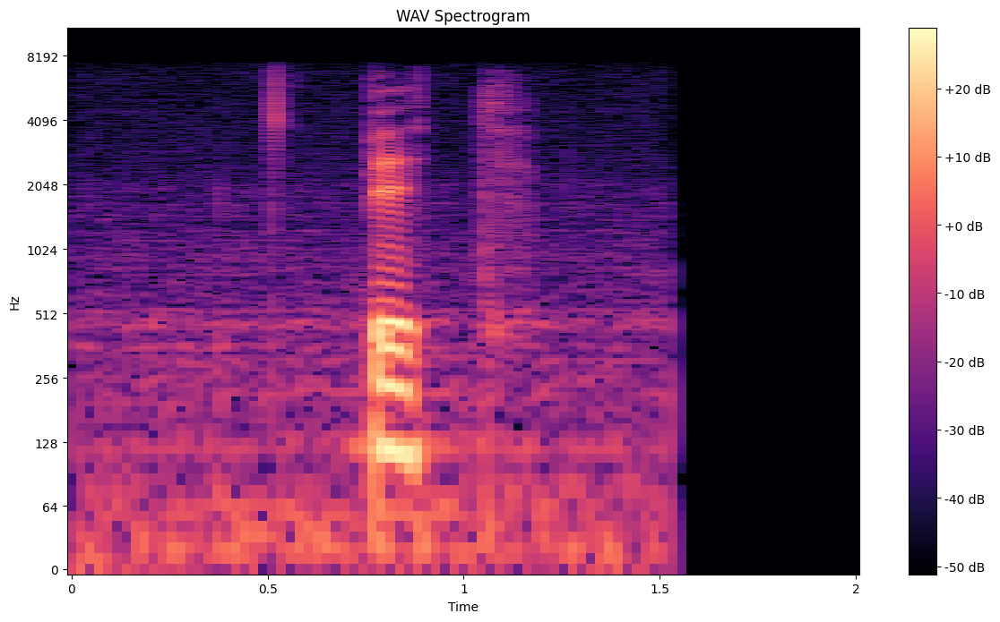

In [248]:

# Plot spectrograms
plt.figure(figsize=(12, 20))

plt.subplot(3, 1, 1)
plt.title('WAV Spectrogram')
librosa.display.specshow(librosa.amplitude_to_db(librosa.stft(wav_data)), sr=wav_sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()

## MP3 Spectogram below

C:\Users\Chief Engineer (C)\AppData\Local\Temp\ipykernel_2304\1431667507.py:7: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  librosa.display.specshow(librosa.amplitude_to_db(librosa.stft(mp3_data)), sr=mp3_sr, x_axis='time', y_axis='log')


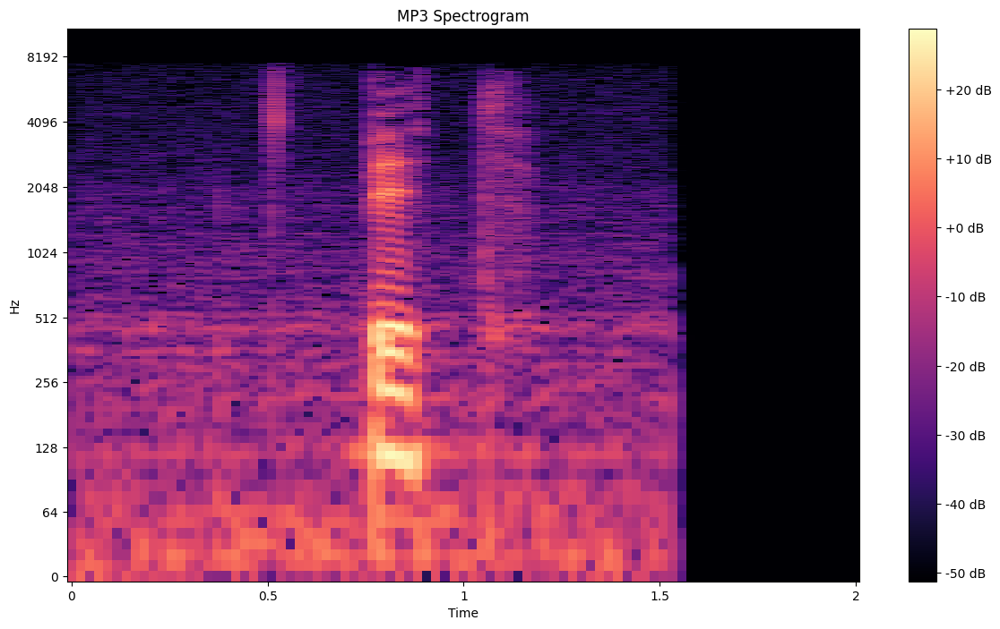

In [249]:
# Plot spectrograms
plt.figure(figsize=(12, 20))


plt.subplot(3, 1, 2)
plt.title('MP3 Spectrogram')
librosa.display.specshow(librosa.amplitude_to_db(librosa.stft(mp3_data)), sr=mp3_sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()

## Flac Spectogram below

C:\Users\Chief Engineer (C)\AppData\Local\Temp\ipykernel_2304\712485301.py:6: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  librosa.display.specshow(librosa.amplitude_to_db(librosa.stft(flac_data)), sr=flac_sr, x_axis='time', y_axis='log')


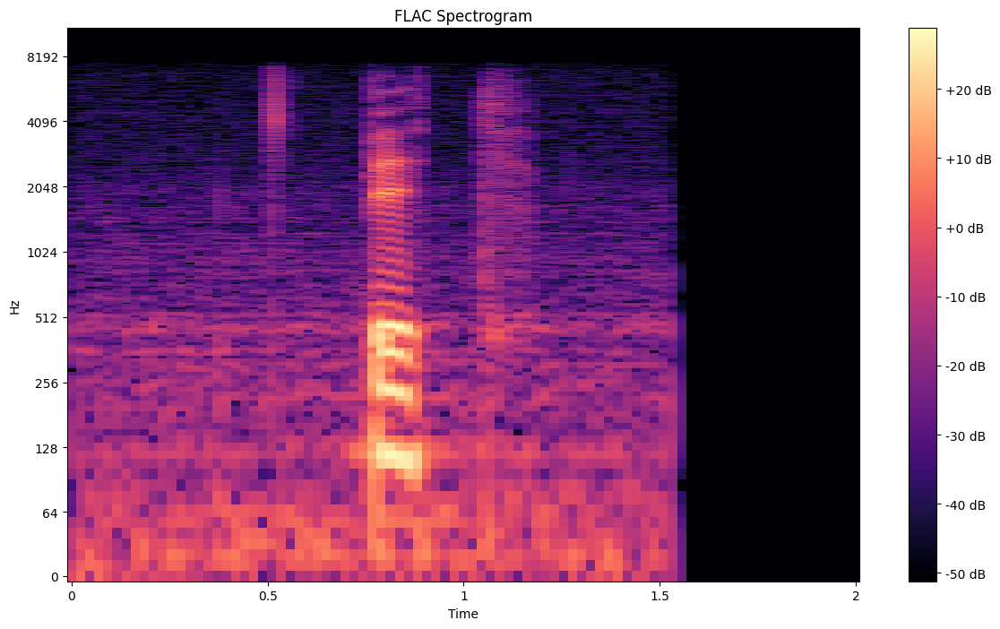

In [250]:
# Plot spectrograms
plt.figure(figsize=(12, 20))

plt.subplot(3, 1, 3)
plt.title('FLAC Spectrogram')
librosa.display.specshow(librosa.amplitude_to_db(librosa.stft(flac_data)), sr=flac_sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()


#### The spectrograms of the three formats (WAV, FLAC, MP3) look quite similar visually.
#### Spectrograms capture the frequency content of the audio signal over time. 
#### There is almost no loss in conversion of formats
